In [1]:
# --- Imports ---

# Standard Libraries
import os  # Provides access to operating system functionalities such as path and directory operations.
import io  # Handles file streams, often used with BytesIO for binary data.
import json  # Parses and generates JSON data, commonly used for APIs and data files.
import base64  # Converts between binary data and Base64 encoding (e.g., embedding images in HTML/JSON).
from io import BytesIO  # In-memory file-like object, often used for handling binary image data.
from collections import defaultdict  # Dictionary subclass that provides default values for missing keys.
import itertools  # Functions for creating efficient iterators (e.g., combinations, permutations, product)

# Core Third-Party Data Processing Libraries
import numpy as np  # Fundamental scientific computing library for efficient array and matrix operations.
import pandas as pd  # Powerful data analysis and manipulation library with the DataFrame structure.

# Visualization Libraries (Matplotlib + Plotly)
import matplotlib.pyplot as plt  # One of the most commonly used plotting libraries in Python.
from matplotlib import gridspec  # Provides tools for creating complex subplot layouts.
from matplotlib.colors import Normalize  # Normalizes data to [0, 1], often used for color mapping.
from matplotlib.patches import FancyArrowPatch  # Draws arrows with customizable styles.
from matplotlib.offsetbox import OffsetImage, AnnotationBbox  # Embeds images inside plots.
import matplotlib.patheffects as path_effects  # Adds visual effects to text (e.g., shadow, outline).

import plotly.graph_objects as go  # Object-oriented interface for Plotly.
from plotly.graph_objects import Figure, Scatter  # Core components for creating interactive figures.
from plotly.subplots import make_subplots  # Creates subplot layouts.
import plotly.express as px  # High-level interface for quickly generating Plotly charts.

from mplsoccer import Pitch  # Specialized football visualization library for plotting pitches and tactical events.

# Image Processing Library
from PIL import Image  # Image processing library for opening, editing, and saving images.

# Network Graph and Structural Analysis
import networkx as nx  # Creates and visualizes network structures (e.g., passing networks, social graphs).

# Statistical Analysis Library (Scipy)
from scipy.stats import (
    friedmanchisquare,  # Non-parametric test for more than two related samples.
    wilcoxon            # Non-parametric test for paired samples.
)

In [2]:
# Define a function named load_event_data that takes one parameter filepath, the path to the event data file (usually a .json file).
def load_event_data(filepath):  
    with open(filepath, 'r', encoding='utf-8') as f:  # Use open() in read mode ('r') with UTF-8 encoding to open the file.
        return pd.json_normalize(json.load(f))  # Flatten the nested JSON data structure into a tabular DataFrame.


In [3]:
# Define a function named load_lineup_data that takes one parameter file_path, the path to the lineup .json file.
def load_lineup_data(file_path):  
    with open(file_path, encoding='utf-8') as f:
        lineup_data = json.load(f)  # Use json.load(f) to read and parse the JSON file into a Python data structure.
    return pd.DataFrame(lineup_data)  # Convert the parsed lineup_data list into a pandas DataFrame (2D table).


In [4]:
# Load competitions.json, which is the master table of competition information in the StatsBomb open data
competitions = load_event_data('open-data-master/data/competitions.json')  
competitions


,competition_id,season_id,country_name,competition_name,competition_gender,competition_youth,competition_international,season_name,match_updated,match_updated_360,match_available_360,match_available
0,9,281,Germany,1. Bundesliga,male,False,False,2023/2024,2024-07-15T14:15:54.671676,2024-07-15T14:17:00.877356,2024-07-15T14:17:00.877356,2024-07-15T14:15:54.671676
1,9,27,Germany,1. Bundesliga,male,False,False,2015/2016,2024-05-19T11:11:14.192381,None,None,2024-05-19T11:11:14.192381
2,1267,107,Africa,African Cup of Nations,male,False,True,2023,2024-06-13T07:51:02.452825,None,None,2024-06-13T07:51:02.452825
3,16,4,Europe,Champions League,male,False,False,2018/2019,2024-06-12T07:44:38.559714,2021-06-13T16:17:31.694,None,2024-06-12T07:44:38.559714
4,16,1,Europe,Champions League,male,False,False,2017/2018,2024-02-13T02:35:28.134882,2021-06-13T16:17:31.694,None,2024-02-13T02:35:28.134882
...,...,...,...,...,...,...,...,...,...,...,...,...
69,55,43,Europe,UEFA Euro,male,False,True,2020,2024-04-16T12:44:40.558402,2024-04-16T12:47:18.505110,2024-04-16T12:47:18.505110,2024-04-16T12:44:40.558402
70,35,75,Europe,UEFA Europa League,male,False,False,1988/1989,2024-02-12T14:45:05.702250,2021-06-13T16:17:31.694,None,2024-02-12T14:45:05.702250
71,53,106,Europe,UEFA Women's Euro,female,False,True,2022,2024-02-13T13:27:17.178263,2024-02-13T13:30:52.820588,2024-02-13T13:30:52.820588,2024-02-13T13:27:17.178263
72,72,107,International,Women's World Cup,female,False,True,2023,2024-07-14T16:59:48.469596,2024-07-14T17:01:38.887279,2024-07-14T17:01:38.887279,2024-07-14T16:59:48.469596


In [5]:
# Filter all rows from the competitions table where the "competition_name" column contains "Champions League"
EUChampions = competitions[competitions["competition_name"].str.contains("Champions League")]
EUChampions


,competition_id,season_id,country_name,competition_name,competition_gender,competition_youth,competition_international,season_name,match_updated,match_updated_360,match_available_360,match_available
3,16,4,Europe,Champions League,male,False,False,2018/2019,2024-06-12T07:44:38.559714,2021-06-13T16:17:31.694,None,2024-06-12T07:44:38.559714
4,16,1,Europe,Champions League,male,False,False,2017/2018,2024-02-13T02:35:28.134882,2021-06-13T16:17:31.694,None,2024-02-13T02:35:28.134882
5,16,2,Europe,Champions League,male,False,False,2016/2017,2024-02-13T02:37:32.205154,2021-06-13T16:17:31.694,None,2024-02-13T02:37:32.205154
6,16,27,Europe,Champions League,male,False,False,2015/2016,2024-06-12T07:45:38.786894,2021-06-13T16:17:31.694,None,2024-06-12T07:45:38.786894
7,16,26,Europe,Champions League,male,False,False,2014/2015,2024-02-12T12:49:54.914228,2021-06-13T16:17:31.694,None,2024-02-12T12:49:54.914228
8,16,25,Europe,Champions League,male,False,False,2013/2014,2024-02-12T12:48:48.479157,2021-06-13T16:17:31.694,None,2024-02-12T12:48:48.479157
9,16,24,Europe,Champions League,male,False,False,2012/2013,2024-02-12T12:47:34.340413,2021-06-13T16:17:31.694,None,2024-02-12T12:47:34.340413
10,16,23,Europe,Champions League,male,False,False,2011/2012,2024-02-13T02:36:35.698340,2021-06-13T16:17:31.694,None,2024-02-13T02:36:35.698340
11,16,22,Europe,Champions League,male,False,False,2010/2011,2024-02-12T12:53:03.944320,2021-06-13T16:17:31.694,None,2024-02-12T12:53:03.944320
12,16,21,Europe,Champions League,male,False,False,2009/2010,2024-02-12T12:49:25.017694,2021-06-13T16:17:31.694,None,2024-02-12T12:49:25.017694


In [6]:
EUChampions18 = load_event_data('open-data-master/data/matches/16/1.json')  # Load the 2017/2018 season Champions League match list
EUChampions17 = load_event_data('open-data-master/data/matches/16/2.json')  # Load the 2016/2017 season Champions League match list
EUChampions16 = load_event_data('open-data-master/data/matches/16/27.json') # Load the 2015/2016 season Champions League match list


In [7]:
EUChampions18

,match_id,match_date,kick_off,home_score,away_score,match_status,match_status_360,last_updated,last_updated_360,match_week,...,competition_stage.id,competition_stage.name,stadium.id,stadium.name,stadium.country.id,stadium.country.name,referee.id,referee.name,referee.country.id,referee.country.name
0,18245,2018-05-26,20:45:00.000,3,1,available,scheduled,2021-01-23T21:55:30.425330,2021-06-13T16:17:31.694,7,...,26,Final,4222,NSK Olimpiyskyi,238,Ukraine,727,Milorad Mažić,203,Serbia


In [8]:
# Filter and display only the required fields to easily view the basic match information
EUChampions18[['match_id','home_score','away_score','season.season_name','home_team.home_team_name','home_team.managers','away_team.away_team_name','away_team.managers']]


,match_id,home_score,away_score,season.season_name,home_team.home_team_name,home_team.managers,away_team.away_team_name,away_team.managers
0,18245,3,1,2017/2018,Real Madrid,"[{'id': 56, 'name': 'Zinédine Zidane', 'nickna...",Liverpool,"[{'id': 94, 'name': 'Jürgen Klopp', 'nickname'..."


In [9]:
EUChampions17[['match_id','home_score','away_score','season.season_name','home_team.home_team_name','home_team.managers','away_team.away_team_name','away_team.managers']]

,match_id,home_score,away_score,season.season_name,home_team.home_team_name,home_team.managers,away_team.away_team_name,away_team.managers
0,18244,1,4,2016/2017,Juventus,"[{'id': 181, 'name': 'Massimiliano Allegri', '...",Real Madrid,"[{'id': 56, 'name': 'Zinédine Zidane', 'nickna..."


In [10]:
EUChampions16[['match_id','home_score','away_score','season.season_name','home_team.home_team_name','home_team.managers','away_team.away_team_name','away_team.managers']]

,match_id,home_score,away_score,season.season_name,home_team.home_team_name,home_team.managers,away_team.away_team_name,away_team.managers
0,18243,1,1,2015/2016,Real Madrid,"[{'id': 56, 'name': 'Zinédine Zidane', 'nickna...",Atlético Madrid,"[{'id': 230, 'name': 'Diego Pablo Simeone', 'n..."


In [11]:
EUChampions18finalevent = load_event_data('open-data-master/data/events/18245.json')  # Load the 2018 final event data
EUChampions17finalevent = load_event_data('open-data-master/data/events/18244.json')  # Load the 2017 final event data  
EUChampions16finalevent = load_event_data('open-data-master/data/events/18243.json')  # Load the 2016 final event data  


In [12]:
EUChampions18finallineup = load_lineup_data('open-data-master/data/lineups/18245.json')  # Load the 2018 final lineups for both teams
EUChampions17finallineup = load_lineup_data('open-data-master/data/lineups/18244.json')  # Load the 2017 final lineups for both teams
EUChampions16finallineup = load_lineup_data('open-data-master/data/lineups/18243.json')  # Load the 2016 final lineups for both teams

RM_lineup16 = EUChampions16finallineup.loc[0, "lineup"]  # Load Real Madrid's lineup in the 2016 final
AM_lineup16 = EUChampions16finallineup.loc[1, "lineup"]  # Load Atlético Madrid's lineup in the 2016 final
RM_lineup17 = EUChampions17finallineup.loc[0, "lineup"]  # Load Real Madrid's lineup in the 2017 final
JV_lineup17 = EUChampions17finallineup.loc[1, "lineup"]  # Load Juventus's lineup in the 2017 final
LP_lineup18 = EUChampions18finallineup.loc[0, "lineup"]  # Load Liverpool's lineup in the 2018 final
RM_lineup18 = EUChampions18finallineup.loc[1, "lineup"]  # Load Real Madrid's lineup in the 2018 final


In [13]:
# Define a function get_team_logo, which takes one input parameter team_name (string), 
# e.g., "Real Madrid", "Juventus", etc.
def get_team_logo(team_name): 
    team_logos = {
        "Real Madrid": "images/Real_Madrid_FC.svg.png",
        "Atlético Madrid": "images/Atletico_Madrid_FC.svg.png",
        "Juventus": "images/Juventus_FC.svg.png",
        "Liverpool": "images/Liverpool_FC.svg.png"
    }   # A dictionary mapping team names to their corresponding logo file paths.
    
    file_path = team_logos.get(team_name)  # Retrieve the image file path for the given team_name from the dictionary.
    
    # If team_name is not in the dictionary (i.e., no corresponding logo file path), return None to indicate that
    # the logo cannot be found.
    if not file_path:
        return None   
    
    # Open the image file (file_path) in binary read mode ("rb") to read its raw byte content.
    with open(file_path, "rb") as f:
        encoded = base64.b64encode(f.read()).decode()
        
        # Return an HTML-compatible Base64 image string that can be directly used in <img src="..."> 
        # or embedded in Plotly charts as a logo.
        return f"data:image/png;base64,{encoded}" 

# "data:image/png;base64,[BASE64 encoded image data]" follows the Data URI Scheme standard on the Web, 
# allowing you to embed image data directly in a webpage or chart without needing a separate image file path or URL.


In [14]:
# Define a function build_name_nickname_map, which converts a player list into a mapping dictionary: 
# "player real name → nickname".
def build_name_nickname_map(players):
    name_nickname_map = {}   # Create an empty dictionary to store the mapping between names and nicknames.
    for p in players:  # Iterate through the player list, where each p is a player dictionary.
        name = p.get("player_name")
        nickname = p.get("player_nickname")
        
        # If name exists: use the nickname if available; otherwise, fall back to the real name.
        if name:
            name_nickname_map[name] = nickname if nickname else name
    return name_nickname_map

# Function call: concatenate player lists from all matches and pass them into the function. 
# The final nickname_map is a unified mapping of nicknames, which can be used later for consistent player display.
nickname_map = build_name_nickname_map(RM_lineup16 + AM_lineup16 + RM_lineup17 + JV_lineup17 + RM_lineup18 + LP_lineup18)


In [15]:
# Custom function: replace player names in the lineup with their nicknames
def replace_lineup_names(df, nickname_map):
    df = df.copy()  # Create a copy of the input DataFrame to avoid modifying the original data
    for idx, row in df.iterrows():  # Iterate through each row of the DataFrame: idx = row index; row = row content (a Series object).
        lineup = row['lineup']  # Extract the 'lineup' field from the current row (a list of player dictionaries).
        updated_lineup = []  # Prepare a new list to store updated player dictionaries with nicknames.
        for player in lineup:  # Iterate over each player in the original lineup
            new_player = player.copy()  # Copy the player dictionary to avoid modifying the original directly.
            name = new_player.get('player_name')  # Get the player's name from the dictionary.
            if name:  # If a name exists, try to find the corresponding nickname in nickname_map
                # If no nickname is found, keep the original name (the second parameter of get() is the default value).
                new_player['player_name'] = nickname_map.get(name, name)
            updated_lineup.append(new_player)  # Add the updated player dictionary to the new lineup list.
        df.at[idx, 'lineup'] = updated_lineup  # Write the updated lineup back into the DataFrame's 'lineup' column.
    return df

# Function calls
EUChampions16finallineup = replace_lineup_names(EUChampions16finallineup, nickname_map)
EUChampions17finallineup = replace_lineup_names(EUChampions17finallineup, nickname_map)
EUChampions18finallineup = replace_lineup_names(EUChampions18finallineup, nickname_map)


In [16]:
# 0 represents the home team, 1 represents the away team.
RM_lineup16 = EUChampions16finallineup.loc[0, "lineup"]  # Extract Real Madrid's 2016 lineup
AM_lineup16 = EUChampions16finallineup.loc[1, "lineup"]  # Extract Atlético Madrid's 2016 lineup
RM_lineup17 = EUChampions17finallineup.loc[0, "lineup"]  # Extract Real Madrid's 2017 lineup
JV_lineup17 = EUChampions17finallineup.loc[1, "lineup"]  # Extract Juventus's 2017 lineup
LP_lineup18 = EUChampions18finallineup.loc[0, "lineup"]  # Extract Liverpool's 2018 lineup
RM_lineup18 = EUChampions18finallineup.loc[1, "lineup"]  # Extract Real Madrid's 2018 lineup


In [17]:
# Custom function to extract the starting player lineup
def get_starting_player_names(lineup_list):
    starting_names = []  # List to store the names of starting players.
    for player in lineup_list:  # Iterate through each player in the lineup
        positions = player.get('positions', [])  # Get the value of the "positions" key from the player dictionary. 
                                                 # If the key does not exist, return an empty list [] to avoid errors.
        if positions and positions[0].get('start_reason') == 'Starting XI':
            # Double condition: if positions is not empty (the player has position info) 
            # and the reason for being on the field at the start is 'Starting XI', 
            # then this player is a starter.
            # If the condition is met, append the player's "player_name" to the starting_names list.
            starting_names.append(player['player_name'])   
    return starting_names  # Return the list of all starting player names.


RM_startingplayer16 = get_starting_player_names(RM_lineup16)  # Extract Real Madrid's 2016 starting lineup
AM_startingplayer16 = get_starting_player_names(AM_lineup16)  # Extract Atlético Madrid's 2016 starting lineup
RM_startingplayer17 = get_starting_player_names(RM_lineup17)  # Extract Real Madrid's 2017 starting lineup
JV_startingplayer17 = get_starting_player_names(JV_lineup17)  # Extract Juventus's 2017 starting lineup
RM_startingplayer18 = get_starting_player_names(RM_lineup18)  # Extract Real Madrid's 2018 starting lineup
LP_startingplayer18 = get_starting_player_names(LP_lineup18)  # Extract Liverpool's 2018 starting lineup


In [18]:
# Custom function: replace player names in the event data, prioritizing nicknames; if no nickname is found, keep the original name.
def replace_player_names_in_events_df(events_df, nickname_map):
    events_df = events_df.copy()  # Use .copy() to create a copy to avoid modifying the original DataFrame directly.
    events_df['player.name'] = events_df['player.name'].apply(
        lambda name: nickname_map.get(name, name) if pd.notna(name) else name
    )  # If name is not NaN (pd.notna(name)): use nickname_map.get(name, name). 
       # If a nickname exists in the mapping, use it; otherwise, keep the original name.
       # If name is NaN (e.g., the event has no associated player), keep the original value.
    
    # Some events (e.g., shots, tackles) may not have the column "pass.recipient.name". 
    # First check whether the column exists to avoid errors when accessing it.
    # If "pass.recipient.name" exists, also replace names with nicknames using nickname_map; otherwise, keep the original names.
    if 'pass.recipient.name' in events_df.columns:
        events_df['pass.recipient.name'] = events_df['pass.recipient.name'].apply(
            lambda name: nickname_map.get(name, name) if pd.notna(name) else name
        )
    return events_df  # Return the DataFrame after replacement.

# Apply to the 3 final matches
EUChampions16finalevent = replace_player_names_in_events_df(EUChampions16finalevent, nickname_map)
EUChampions17finalevent = replace_player_names_in_events_df(EUChampions17finalevent, nickname_map)
EUChampions18finalevent = replace_player_names_in_events_df(EUChampions18finalevent, nickname_map)


In [19]:
# Custom function: filter "successful pass" events for a given team from the event data.
def filter_successful_passes(events_df, team_name):
    return events_df[(events_df['team.name'] == team_name) &
                      (events_df['type.name'] == 'Pass') &
                      (events_df['pass.outcome.name'].isna())]
# Multi-condition filtering: keep only the rows where the team matches, 
# the event type is "Pass", and pass.outcome.name is empty (NaN), meaning the pass was successful.

# Apply to both teams in the 3 final matches
RM_passes_2018 = filter_successful_passes(EUChampions18finalevent, 'Real Madrid')
RM_passes_2017 = filter_successful_passes(EUChampions17finalevent, 'Real Madrid')
RM_passes_2016 = filter_successful_passes(EUChampions16finalevent, 'Real Madrid')
LP_passes_2018 = filter_successful_passes(EUChampions18finalevent, 'Liverpool')
JV_passes_2017 = filter_successful_passes(EUChampions17finalevent, 'Juventus')
AM_passes_2016 = filter_successful_passes(EUChampions16finalevent, 'Atlético Madrid')


In [20]:
# Custom function: filter successful passes between the starting players of a given team (matched by player.id).
def filter_successful_passes_by_starting_players(events_df, team_name, starting_players, lineup_df):
    # Extract starting player IDs
    team_lineup = lineup_df[lineup_df["team_name"] == team_name]
    if team_lineup.empty:
        raise ValueError(f"Team not found in lineup: {team_name}")

    lineup = team_lineup.iloc[0]["lineup"]
    if isinstance(lineup, str):
        import json
        lineup = json.loads(lineup)

    starting_ids = set()
    for p in lineup:
        positions = p.get("positions", [])
        if positions and positions[0].get("start_reason") == "Starting XI":
            starting_ids.add(p["player_id"])

    # Successful passes by this team
    passes = events_df[
        (events_df["team.name"] == team_name) &
        (events_df["type.name"] == "Pass") &
        (events_df["pass.outcome.name"].isna())
    ]

    # Keep only passes where both passer and recipient are starting players
    filtered = passes[
        passes["player.id"].isin(starting_ids) &
        passes["pass.recipient.id"].isin(starting_ids)
    ].copy()

    return filtered


# Apply to the finals for both teams
RM_Sp_passes_2016 = filter_successful_passes_by_starting_players(EUChampions16finalevent, "Real Madrid", RM_startingplayer16, EUChampions16finallineup)
RM_Sp_passes_2017 = filter_successful_passes_by_starting_players(EUChampions17finalevent, "Real Madrid", RM_startingplayer17, EUChampions17finallineup)
RM_Sp_passes_2018 = filter_successful_passes_by_starting_players(EUChampions18finalevent, "Real Madrid", RM_startingplayer18, EUChampions18finallineup)
AM_Sp_passes_2016 = filter_successful_passes_by_starting_players(EUChampions16finalevent, "Atlético Madrid", AM_startingplayer16, EUChampions16finallineup)
JV_Sp_passes_2017 = filter_successful_passes_by_starting_players(EUChampions17finalevent, "Juventus", JV_startingplayer17, EUChampions17finallineup)
LP_Sp_passes_2018 = filter_successful_passes_by_starting_players(EUChampions18finalevent, "Liverpool", LP_startingplayer18, EUChampions18finallineup)


In [21]:
# Custom function: calculate various technical statistics at both team and player levels 
# from event data and lineup data, then export the results of multiple matches into two CSV files.
def get_match_stats_comparison(events_df, team1_lineup, team2_lineup, team1, team2):
    events_df = events_df[events_df['period'] <= 4]  # Keep regular time + extra time, remove penalty shootout data.

    # Convert "mm:ss" into minutes (float). For example, "01:30" → 1.5 minutes. 
    # If no time string exists, return None.
    def parse_minutes(time_str):
        if time_str:  # Check if time_str has a value (not None, not empty string). Otherwise, return None directly.
            mins, secs = map(int, time_str.split(":"))  # Convert both strings to integers, assign to mins and secs.
            return round(mins + secs / 60, 0)
        return None

    # Build a dictionary {player_id: position}.
    def build_id_to_position(lineup_list):
        id_to_position = {}  # Empty dict to store {player_id: position}.
        # Iterate through each player in the lineup. Get "player_id" (unique ID) and "positions" list.
        # If "positions" is missing, default to [] to avoid errors.
        for player in lineup_list:
            pid = player.get("player_id")
            positions = player.get("positions", [])
            # If positions exists and is a list, get the "position" field. If missing, default to 'Unknown'.
            if positions and isinstance(positions, list):
                pos_name = positions[0].get('position', 'Unknown')
            else:    
                pos_name = "Unknown"
            id_to_position[pid] = pos_name  # Store the mapping in the dictionary.
        return id_to_position

    # Calculate total minutes played for each player and build mappings: {player_id: minutes}, {player_id: name}.
    def get_player_minutes_and_name(lineup_list):
        players_minutes = {}  # Player ID → minutes played.
        player_id_to_name = {}  # Player ID → name.
        # Iterate through each player, extract ID and name, and store {ID: name}.
        for player in lineup_list:
            player_id = player.get('player_id')
            player_name = player.get('player_name')
            player_id_to_name[player_id] = player_name
            
            minutes = 0
            # Iterate through the player's positions list
            for pos in player.get('positions', []):
                start = parse_minutes(pos.get('from'))  # Convert "from" time into minutes.
                end = parse_minutes(pos.get('to'))  # Convert "to" time into minutes.
                if start is not None:
                    # If end exists, use it; otherwise set to 90.0
                    end = end if end is not None else 90.0
                    # Add this playing duration to total minutes, but if negative, use 0 to avoid invalid values.
                    minutes += max(0, end - start) 
            players_minutes[player_id] = round(minutes, 0)
        return players_minutes, player_id_to_name

    # Extract all card events (yellow, red) for a given team or player from event data.
    # team_or_player_column: column used as filter. value: filter condition (team name or player ID).
    def extract_cards(events_df, team_or_player_column, value):
        # Filter event types: 'Foul Committed','Bad Behaviour','Player Off'
        # Also keep only rows where team_or_player_column == value (team or player).
        cards_df = events_df[
            (events_df['type.name'].isin(['Foul Committed','Bad Behaviour','Player Off'])) &
            (events_df[team_or_player_column]==value)
        ].copy()

        # Iterate over possible card columns
        for col in ['foul_committed.card.name','bad_behaviour.card.name','player_off.card.name']:
            # If column doesn’t exist (e.g., no such events in this match), add it with None to avoid merge errors.
            if col not in cards_df.columns:
                cards_df[col]=None
        # Merge the three columns into one card_name column by forward-filling non-empty values.
        cards_df['card_name'] = cards_df[['foul_committed.card.name',
                                          'bad_behaviour.card.name',
                                          'player_off.card.name']].bfill(axis=1).iloc[:,0]
        return cards_df

    # Compute team-level match statistics
    def compute_team_stats(events_df, team_name):
        team_df = events_df[events_df['team.name'] == team_name]  # Keep only events for this team.
        total_time = events_df['duration'].sum()  # Total match duration (sum of all event durations).
        team_time = team_df['duration'].sum()  # Ball possession time (sum of this team’s event durations).

        passes = team_df[team_df['type.name'] == 'Pass']  # All passes
        successful_passes = passes[passes['pass.outcome.name'].isna()]  # Successful passes
        crosses = passes[passes['pass.cross'] == True]  # Crosses
        successful_crosses = crosses[crosses['pass.outcome.name'].isna()]  # Successful crosses
        key_passes = passes[passes['pass.assisted_shot_id'].notna()]  # Key passes leading to a shot
        assists = team_df[team_df['pass.goal_assist'] == True] if 'pass.goal_assist' in team_df.columns else pd.DataFrame()
        shots = team_df[team_df['type.name'] == 'Shot']  # All shots
        shots_on_target = shots[shots['shot.outcome.name'].isin(['Goal', 'Saved', 'Saved To Post'])]  # Shots on target
        goals = shots[shots['shot.outcome.name'] == 'Goal']  # Goals
        xg = shots['shot.statsbomb_xg'].sum() if 'shot.statsbomb_xg' in shots.columns else 0.0  # Expected Goals

        # Count penalties during regular time. If shot.penalty is True, or shot.type.name contains "Penalty", count it.
        penalties_count = sum(
            bool(shot.get('shot.penalty')) or (
                isinstance(shot.get('shot.type.name'), str) and 'Penalty' in shot.get('shot.type.name')
            )
            for _, shot in shots.iterrows()
        )

        # Extract card events and count yellows and reds
        cards_df = extract_cards(events_df, 'team.name', team_name)
        yellow_cards = len(cards_df[cards_df['card_name']=='Yellow Card'])
        red_cards = len(cards_df[cards_df['card_name']=='Red Card'])

        # Opponent’s shots
        opponent_shots = events_df[
            (events_df['team.name'] != team_name) &
            (events_df['type.name'] == 'Shot')
        ]
        # Goalkeeper saves (including saved and saved to post)
        saves = len(opponent_shots[
            opponent_shots['shot.outcome.name'].isin(['Saved', 'Saved To Post'])
        ])

        # Pass accuracy
        pass_accuracy_pct = (len(successful_passes)/len(passes)*100) if len(passes) > 0 else 0
        pass_success_rate = pass_accuracy_pct

        # Possession %
        possession_pct = (team_time / total_time * 100) if total_time > 0 else 0

        # Collect into dict
        stats = {
            'team': team_name,
            'shots': len(shots),
            'shots on target': len(shots_on_target),
            'goals': len(goals),
            'xG': round(xg, 2),
            'passes': len(passes),
            'successful passes': len(successful_passes),
            'pass success rate': f"{int(round(pass_success_rate))}%",
            'crosses': len(crosses),
            'successful crosses': len(successful_crosses),
            'key passes': len(key_passes),
            'assists': len(assists),
            'saves': saves,
            'duels': len(team_df[team_df['type.name'] == 'Duel']),
            'interceptions': len(team_df[team_df['type.name'] == 'Interception']),
            'clearances': len(team_df[team_df['type.name'] == 'Clearance']),
            'blocks': len(team_df[team_df['type.name'] == 'Block']),
            'fouls committed': len(team_df[team_df['type.name'] == 'Foul Committed']),
            'fouls won': len(team_df[team_df['type.name'] == 'Foul Won']),
            'yellow cards': yellow_cards,
            'red cards': red_cards,
            'corner kicks': len(team_df[team_df['pass.type.name'] == 'Corner']),
            'free kicks': len(team_df[team_df['pass.type.name'] == 'Free Kick']),
            'penalties': penalties_count,
            'possession': f"{int(round(possession_pct))}%"
        }
        return stats, team_df

    # Compute player-level statistics
    def compute_player_stats(events_df, team_df, minutes_dict, id_to_name_dict, id_to_position_dict, opponent_team_name):
        player_stats = []
        opponent_shots = events_df[
            (events_df['team.name'] == opponent_team_name) &
            (events_df['type.name'] == 'Shot')
        ]  # Cache opponent’s shots for goalkeeper stats.

        # Iterate over each player, filter their events. Use mappings for name/position, fallback if missing.
        for player_id in team_df['player.id'].dropna().unique():
            player_df = team_df[team_df['player.id'] == player_id]
            player_name = id_to_name_dict.get(player_id, player_df['player.name'].iloc[0])
            position = id_to_position_dict.get(player_id, "Unknown")

            # Passing & attacking stats
            p_pass = player_df[
                (player_df['type.name'] == 'Pass') &
                (~player_df['pass.type.name'].isin(['Throw-in', 'Kick Off']))
            ]  # Passes excluding throw-ins and kick-offs
            p_pass_success = p_pass[p_pass['pass.outcome.name'].isna()]  # Successful passes
            p_key = p_pass[p_pass['pass.assisted_shot_id'].notna()]  # Key passes
            p_assists = p_pass[p_pass['pass.goal_assist'] == True] if 'pass.goal_assist' in player_df.columns else pd.DataFrame()
            p_shots = player_df[player_df['type.name'] == 'Shot']  # Shots
            p_shots_on_target = p_shots[p_shots['shot.outcome.name'].isin(['Goal', 'Saved', 'Saved To Post'])]  # Shots on target
            p_goals = p_shots[p_shots['shot.outcome.name'] == 'Goal']  # Goals
            xg = p_shots['shot.statsbomb_xg'].sum() if 'shot.statsbomb_xg' in p_shots.columns else 0.0

            # Defensive & fouls
            p_duel = player_df[player_df['type.name'] == 'Duel']
            p_intercept = player_df[player_df['type.name'] == 'Interception']
            p_clear = player_df[player_df['type.name'] == 'Clearance']
            p_block = player_df[player_df['type.name'] == 'Block']
            p_foul_commit = player_df[player_df['type.name'] == 'Foul Committed']
            p_foul_won = player_df[player_df['type.name'] == 'Foul Won']

            # Cards
            cards_df = extract_cards(events_df, 'player.id', player_id)
            yellow_cards = len(cards_df[cards_df['card_name']=='Yellow Card'])
            red_cards = len(cards_df[cards_df['card_name']=='Red Card'])

            # Goalkeeper-specific stats
            if 'goalkeeper' in str(position).lower():
                saves = 0
                goals_conceded = 0
                penalty_saves = 0
                for _, shot in opponent_shots.iterrows():
                    if shot.get('shot.outcome.name') == 'Goal':  
                        goals_conceded += 1
                    elif shot.get('shot.outcome.name') in ['Saved', 'Saved To Post']: 
                        saves += 1
                        if shot.get('shot.penalty', False):
                            penalty_saves += 1
                total_shots_faced = saves + goals_conceded
                save_percentage = (saves / total_shots_faced * 100) if total_shots_faced > 0 else 0
                clean_sheets = 1 if goals_conceded == 0 else 0
            else: 
                saves = 0
                goals_conceded = 0
                penalty_saves = 0
                save_percentage = 0
                clean_sheets = 0

            pass_accuracy_pct = (len(p_pass_success)/len(p_pass)*100) if len(p_pass) > 0 else 0
            pass_success_rate = pass_accuracy_pct

            # Collect into player stats dict
            player_stats.append({
                'team': player_df['team.name'].iloc[0],
                'player': player_name,
                'minutes played': int(round(minutes_dict.get(player_id, 0))),
                'position': position,
                'passes': len(p_pass),
                'successful passes': len(p_pass_success),
                'pass success rate': f"{int(round(pass_success_rate))}%",
                'key passes': len(p_key),
                'assists': len(p_assists),
                'shots': len(p_shots),
                'shots on target': len(p_shots_on_target),
                'goals': len(p_goals),
                'xG': round(xg, 2),
                'duels': len(p_duel),
                'interceptions': len(p_intercept),
                'clearances': len(p_clear),
                'blocks': len(p_block),
                'fouls committed': len(p_foul_commit),
                'fouls won': len(p_foul_won),
                'yellow cards': yellow_cards,
                'red cards': red_cards,
                'saves': saves,
                'clean sheets': clean_sheets,
                'save percentage': round(save_percentage, 1),
                'penalty saves': penalty_saves
            })
        return pd.DataFrame(player_stats)

    # Build ID→position mappings for both teams
    id_to_position1 = build_id_to_position(team1_lineup)
    id_to_position2 = build_id_to_position(team2_lineup)
    # Get minutes played and name mappings for both teams
    minutes1, id_to_name1 = get_player_minutes_and_name(team1_lineup)
    minutes2, id_to_name2 = get_player_minutes_and_name(team2_lineup)
    # Team stats
    stats1, df1 = compute_team_stats(events_df, team1)
    stats2, df2 = compute_team_stats(events_df, team2)
    # Player stats
    player_df1 = compute_player_stats(events_df, df1, minutes1, id_to_name1, id_to_position1, team2)
    player_df2 = compute_player_stats(events_df, df2, minutes2, id_to_name2, id_to_position2, team1)
    # Combine
    player_stats_df = pd.concat([player_df1, player_df2], ignore_index=True)
    team_comparison_df = pd.DataFrame([stats1, stats2])
    return team_comparison_df, player_stats_df

# Batch process multiple matches (team + player stats) and save results as CSV files.
def run_and_export_stats(matches_dict):
    all_team_stats = []
    all_player_stats = []
    # Iterate through each match
    for match_name, match_data in matches_dict.items():
        # Extract data: events, lineups, and team names
        events_df = match_data['events_df']
        team1_lineup = match_data['team1_lineup']
        team2_lineup = match_data['team2_lineup']
        team1 = match_data['team1']
        team2 = match_data['team2']
        
        # Call the core analysis function, returning two DataFrames: team_stats and player_stats
        team_stats, player_stats = get_match_stats_comparison(
            events_df, team1_lineup, team2_lineup, team1, team2
        )
        # Insert "match" column as the first column, with match name as the value
        team_stats.insert(0, "match", match_name)
        player_stats.insert(0, "match", match_name)
        # Append this match’s DataFrames to the master lists for later concatenation
        all_team_stats.append(team_stats)
        all_player_stats.append(player_stats)
    # Concatenate all matches’ stats
    team_stats_df = pd.concat(all_team_stats, ignore_index=True)
    player_stats_df = pd.concat(all_player_stats, ignore_index=True)
    # Save to CSV
    team_stats_df.to_csv("team_stats_summary.csv", index=False, encoding="utf-8-sig")
    player_stats_df.to_csv("player_stats_summary.csv", index=False, encoding="utf-8-sig")
    return team_stats_df, player_stats_df


# Example call
matches = {
    "2016 Final": {
        "events_df": EUChampions16finalevent,
        "team1_lineup": RM_lineup16,
        "team2_lineup": AM_lineup16,
        "team1": "Real Madrid",
        "team2": "Atlético Madrid"
    },
    "2017 Final": {
        "events_df": EUChampions17finalevent,
        "team1_lineup": RM_lineup17,
        "team2_lineup": JV_lineup17,
        "team1": "Real Madrid",
        "team2": "Juventus"
    },
    "2018 Final": {
        "events_df": EUChampions18finalevent,
        "team1_lineup": RM_lineup18,
        "team2_lineup": LP_lineup18,
        "team1": "Real Madrid",
        "team2": "Liverpool"
    }
}

# Run
team_stats_df, player_stats_df = run_and_export_stats(matches)


In [22]:
team_stats_2016 = team_stats_df[team_stats_df['match'] == '2016 Final']
team_stats_2016 

,match,team,shots,shots on target,goals,xG,passes,successful passes,pass success rate,crosses,...,clearances,blocks,fouls committed,fouls won,yellow cards,red cards,corner kicks,free kicks,penalties,possession
0,2016 Final,Real Madrid,26,7,1,2.58,640,527,82%,19,...,34,26,22,19,6,0,7,16,0,46%
1,2016 Final,Atlético Madrid,18,4,1,2.54,718,579,81%,13,...,19,29,20,21,2,0,6,17,1,54%


In [23]:
team_stats_2017 = team_stats_df[team_stats_df['match'] == '2017 Final']
team_stats_2017 

,match,team,shots,shots on target,goals,xG,passes,successful passes,pass success rate,crosses,...,clearances,blocks,fouls committed,fouls won,yellow cards,red cards,corner kicks,free kicks,penalties,possession
2,2017 Final,Real Madrid,18,5,4,1.57,559,481,86%,14,...,12,20,17,24,3,0,1,26,0,55%
3,2017 Final,Juventus,9,4,1,0.42,442,345,78%,15,...,8,16,26,15,4,1,1,17,0,45%


In [24]:
team_stats_2018 = team_stats_df[team_stats_df['match'] == '2018 Final']
team_stats_2018 

,match,team,shots,shots on target,goals,xG,passes,successful passes,pass success rate,crosses,...,clearances,blocks,fouls committed,fouls won,yellow cards,red cards,corner kicks,free kicks,penalties,possession
4,2018 Final,Real Madrid,14,6,3,1.68,673,596,89%,12,...,17,23,5,18,0,0,9,20,0,63%
5,2018 Final,Liverpool,14,3,1,1.43,360,266,74%,12,...,16,13,20,5,1,0,5,12,0,37%


In [25]:
player_stats_2016 = player_stats_df[player_stats_df['match'] == '2016 Final']
player_stats_2016

,match,team,player,minutes played,position,passes,successful passes,pass success rate,key passes,assists,...,clearances,blocks,fouls committed,fouls won,yellow cards,red cards,saves,clean sheets,save percentage,penalty saves
0,2016 Final,Real Madrid,Karim Benzema,76,Center Forward,27,18,67%,0,0,...,1,3,1,1,0,0,0,0,0.0,0
1,2016 Final,Real Madrid,Sergio Ramos,90,Left Center Back,49,44,90%,0,0,...,8,3,3,1,1,0,0,0,0.0,0
2,2016 Final,Real Madrid,Casemiro,90,Center Defensive Midfield,69,62,90%,1,0,...,4,5,4,2,1,0,0,0,0.0,0
3,2016 Final,Real Madrid,Toni Kroos,72,Left Center Midfield,43,38,88%,1,0,...,0,1,0,3,0,0,0,0,0.0,0
4,2016 Final,Real Madrid,Luka Modrić,90,Right Center Midfield,71,64,90%,7,0,...,1,4,3,0,0,0,0,0,0.0,0
5,2016 Final,Real Madrid,Pepe,90,Right Center Back,48,42,88%,0,0,...,8,1,2,4,1,0,0,0,0.0,0
6,2016 Final,Real Madrid,Marcelo,90,Left Back,65,51,78%,2,0,...,2,4,0,0,0,0,0,0,0.0,0
7,2016 Final,Real Madrid,Cristiano Ronaldo,90,Left Wing,38,30,79%,1,0,...,1,0,1,2,0,0,0,0,0.0,0
8,2016 Final,Real Madrid,Keylor Navas,90,Goalkeeper,40,21,52%,0,0,...,0,0,0,0,1,0,3,0,75.0,0
9,2016 Final,Real Madrid,Daniel Carvajal,51,Right Back,37,32,86%,0,0,...,2,0,1,0,1,0,0,0,0.0,0


In [26]:
player_stats_2017 = player_stats_df[player_stats_df['match'] == '2017 Final']
player_stats_2017

,match,team,player,minutes played,position,passes,successful passes,pass success rate,key passes,assists,...,clearances,blocks,fouls committed,fouls won,yellow cards,red cards,saves,clean sheets,save percentage,penalty saves
28,2017 Final,Real Madrid,Raphaël Varane,90,Right Center Back,48,42,88%,0,0,...,4,3,1,1,0,0,0,0,0.0,0
29,2017 Final,Real Madrid,Luka Modrić,90,Left Center Midfield,58,50,86%,1,1,...,0,2,1,6,0,0,0,0,0.0,0
30,2017 Final,Real Madrid,Daniel Carvajal,90,Right Back,54,47,87%,3,1,...,1,0,5,3,1,0,0,0,0.0,0
31,2017 Final,Real Madrid,Casemiro,90,Center Defensive Midfield,54,50,93%,0,0,...,0,1,1,2,0,0,0,0,0.0,0
32,2017 Final,Real Madrid,Marcelo,90,Left Back,65,53,82%,2,1,...,1,7,0,2,0,0,0,0,0.0,0
33,2017 Final,Real Madrid,Toni Kroos,89,Right Center Midfield,74,66,89%,2,0,...,0,2,2,6,1,0,0,0,0.0,0
34,2017 Final,Real Madrid,Karim Benzema,77,Right Center Forward,21,17,81%,1,0,...,0,0,3,0,0,0,0,0,0.0,0
35,2017 Final,Real Madrid,Cristiano Ronaldo,90,Left Center Forward,21,18,86%,0,0,...,0,2,0,1,0,0,0,0,0.0,0
36,2017 Final,Real Madrid,Sergio Ramos,90,Left Center Back,62,57,92%,0,0,...,5,2,4,1,1,0,0,0,0.0,0
37,2017 Final,Real Madrid,Isco,82,Center Attacking Midfield,52,45,87%,2,0,...,1,1,0,2,0,0,0,0,0.0,0


In [27]:
player_stats_2018 = player_stats_df[player_stats_df['match'] == '2018 Final']
player_stats_2018

,match,team,player,minutes played,position,passes,successful passes,pass success rate,key passes,assists,...,clearances,blocks,fouls committed,fouls won,yellow cards,red cards,saves,clean sheets,save percentage,penalty saves
56,2018 Final,Real Madrid,Raphaël Varane,90,Right Center Back,62,54,87%,0,0,...,7,1,0,0,0,0,0,0,0.0,0
57,2018 Final,Real Madrid,Luka Modrić,90,Right Center Midfield,72,67,93%,0,0,...,0,2,0,1,0,0,0,0,0.0,0
58,2018 Final,Real Madrid,Daniel Carvajal,36,Right Back,27,21,78%,1,0,...,1,4,0,1,0,0,0,0,0.0,0
59,2018 Final,Real Madrid,Casemiro,90,Center Defensive Midfield,38,34,89%,1,0,...,3,9,0,1,0,0,0,0,0.0,0
60,2018 Final,Real Madrid,Karim Benzema,88,Right Center Forward,39,36,92%,2,0,...,0,0,0,1,0,0,0,0,0.0,0
61,2018 Final,Real Madrid,Marcelo,90,Left Back,77,64,83%,3,2,...,1,1,2,1,0,0,0,0,0.0,0
62,2018 Final,Real Madrid,Sergio Ramos,90,Left Center Back,85,78,92%,0,0,...,4,1,0,3,0,0,0,0,0.0,0
63,2018 Final,Real Madrid,Cristiano Ronaldo,90,Left Center Forward,33,31,94%,0,0,...,1,1,0,1,0,0,0,0,0.0,0
64,2018 Final,Real Madrid,Toni Kroos,90,Left Center Midfield,91,83,91%,0,0,...,0,2,1,1,0,0,0,0,0.0,0
65,2018 Final,Real Madrid,Keylor Navas,90,Goalkeeper,22,14,64%,0,0,...,0,0,0,2,0,0,2,0,66.7,0


In [28]:
# This code generates an interactive Plotly table summarizing key team performance statistics from matches and exports it as an HTML file for visualization and sharing.
# Select the required fields and rename columns
selected_columns = ['match', 'team', 'shots', 'goals', 'xG', 'passes', 'pass success rate', 'possession']
table_df = team_stats_df[selected_columns].copy()
table_df.columns = ['Match', 'Team', 'Shots', 'Goals', 'xG', 'Passes', 'Pass Success rate', 'Possession']

# Create a Plotly table
fig = go.Figure(data=[go.Table(
    columnwidth=[90, 120, 60, 60, 60, 70, 120, 90], # Width of each column
    header=dict(
        values=list(table_df.columns), # Table header text
        fill_color='#A3E4D7',          # Table header background color
        align='center',                # Center alignment for header text
        font=dict(size=14, family='Arial'),  # Table header font
        height=35  # Header row height
    ),
    cells=dict(
        values=[table_df[col] for col in table_df.columns],  # Table cell data
        fill_color='white',                 # Cell background color
        align='center',                     # Center alignment for cell text
        font=dict(size=13, family='Arial'), # Table cell font
        height=30  # Row height
    )
)])

# Configure figure layout (center the title)
fig.update_layout(
    title=dict(
        text='Team Performance Summary',
        x=0.5,  # Set the title anchor at 50% of the canvas width (centered).
        xanchor='center',  # Anchor point is the center of the title text.
        font=dict(size=20)  # Title font size
    ),
    height=280,   # Total figure height
    margin=dict(l=20, r=20, t=60, b=1)  # Outer margins
)

fig.show()

# Export the table to an HTML file
# fig.write_html("team_performance_summary.html", include_plotlyjs="cdn", full_html=True)


In [29]:
# Based on player technical statistics for each match, calculate a "composite score", 
# sort in descending order, and return a DataFrame containing all players' scores.
def compute_scores_per_match(player_stats_df, year=None):

    all_scores = []
    # Loop through each match
    for match_name, group in player_stats_df.groupby('match'):
        group = group.copy()  # All player stats for a given match
        
        # Custom scoring formula to calculate player composite score
        group['score'] = (
            group['goals'] * 5 +
            group['assists'] * 3 +
            group['key passes'] * 1 +
            group['xG'] +
            group['interceptions'] * 0.5 +
            group['clearances'] * 0.5 +
            group['blocks'] * 0.5 +
            group['clean sheets'] * 5 +
            group['saves'] * 0.5 +
            group['penalty saves'] * 0.5 
        )

        if year:  # If the "year" parameter is provided, add the year column
            group['year'] = year

        # Sort players by score in descending order so top performers (MVP candidates) appear first
        group = group.sort_values('score', ascending=False)

        all_scores.append(group)  # Add each match’s score table to the all_scores list

    # Combine all matches
    result_df = pd.concat(all_scores, ignore_index=True)

    # Keep only required columns
    result_df = result_df[[
        'year','match','team','player','position','score',
        'goals','assists','xG',
        'key passes','interceptions','clearances','blocks',
        'clean sheets','saves','penalty saves'
    ]]

    return result_df

# Compute scores for all players in each match per year
scores_2016 = compute_scores_per_match(player_stats_2016, year=2016)
scores_2017 = compute_scores_per_match(player_stats_2017, year=2017)
scores_2018 = compute_scores_per_match(player_stats_2018, year=2018)

# Combine all years
all_scores_all_years = pd.concat([scores_2016, scores_2017, scores_2018], ignore_index=True)

# Export all player scores as CSV (optional)
# all_scores_all_years.to_csv("all_player_scores_2016_2017_2018.csv", index=False, encoding="utf-8-sig")

# Select MVP for each match (highest scoring player)
mvp_list = []
for match_name, group in all_scores_all_years.groupby('match'):
    mvp = group.iloc[0]
    mvp_list.append(mvp)

mvp_all_years = pd.DataFrame(mvp_list)

# Export MVP results as CSV (optional)
# mvp_all_years.to_csv("mvp_2016_2017_2018.csv", index=False, encoding="utf-8-sig")

# Display results
mvp_all_years


,year,match,team,player,position,score,goals,assists,xG,key passes,interceptions,clearances,blocks,clean sheets,saves,penalty saves
0,2016,2016 Final,Real Madrid,Sergio Ramos,Left Center Back,11.56,1,0,0.56,0,1,8,3,0,0,0
28,2017,2017 Final,Real Madrid,Cristiano Ronaldo,Left Center Forward,11.77,2,0,0.77,0,0,0,2,0,0,0
56,2018,2018 Final,Real Madrid,Gareth Bale,Center Attacking Midfield,11.55,2,0,0.05,1,0,0,1,0,0,0


In [30]:
# Plot violin plots of player score distributions per match and highlight MVP players (star marker + dashed line).
def plot_violin_scores_with_mvp(all_scores_df, mvp_df, html_filename="mvp_scores_plot.html"):
    df = all_scores_df.copy()  # DataFrame with all player scores
    df["match"] = df["match"].astype(str)  # Convert the "match" column values to string type
    mvp_df = mvp_df.copy()  # MVP DataFrame
    mvp_df["match"] = mvp_df["match"].astype(str)  # Convert the "match" column in MVP DataFrame to string type for consistency

    # Create violin plot (distribution + data points).
    fig = px.violin(
        df,
        x="match",  # Group by match on the X-axis
        y="score",  # Score on the Y-axis
        color="team",  # Color by team
        box=True,   # Add a box plot inside the violin
        points="all", # Show all data points
        hover_data=["player", "position", "score"],  # Show extra info on hover
        color_discrete_sequence=px.colors.qualitative.Set2 # Use a qualitative color scheme
    )
    fig.update_traces(jitter=0.3, scalemode="count")  # jitter=0.3 adds horizontal jitter, scalemode="count" widens violins for more players

    # Create mapping from match categories to numeric index
    match_categories = list(df["match"].unique())  # Unique matches in the order they appear
    match_x_map = {m: i for i, m in enumerate(match_categories)}  # Dictionary: match -> index

    # Add MVP stars and dashed lines
    first_mvp = True  # Flag to ensure "MVP" appears only once in the legend
    for _, row in mvp_df.iterrows():  # Iterate through MVPs
        match_idx = match_x_map[row["match"]]  # Get the numeric X-axis position for the match

        # Add scatter marker + text for MVP star
        fig.add_trace(
            go.Scatter(
                x=[row["match"]],  # X-axis position (match name)
                y=[row["score"]],  # Y-axis position (MVP score)
                mode="markers+text",  # Draw both markers and text
                marker=dict(
                    size=14,  # Star size
                    color="red", # Star color
                    symbol="star" # Star shape
                ),
                text=[f"{row['player']} ({row['score']})"],  # Show player name and score above star
                textposition="top center",   # Text above and centered
                name="MVP" if first_mvp else "",  # Show legend name only once
                hovertemplate=(
                    f"<b>MVP</b><br>"
                    f"Player: {row['player']}<br>"
                    f"Team: {row['team']}<br>"
                    f"Score: {row['score']}"
                ), # Tooltip on hover
                showlegend=first_mvp  # Show legend only for the first MVP
            )
        )
        first_mvp = False  # After first MVP, do not repeat legend entry

        # Find MVP’s original score point and draw dashed line to star
        player_points = df[
            (df["match"] == row["match"]) &  
            (df["player"] == row["player"])  
        ]
        if not player_points.empty:  # If player data exists
            y_player_score = player_points.iloc[0]["score"]  # Player's score
            fig.add_shape(
                type="line",  # Add line
                x0=match_idx - 0.35,  # Start slightly to the left
                x1=match_idx, # End at MVP star position
                y0=y_player_score, # Start at original score
                y1=row["score"], # End at star score
                line=dict(
                    color="red",
                    width=2,
                    dash="dot"  # Dotted line
                )
            )

    # Add logos below X-axis (left and right)
    for match in match_categories:  # Iterate through matches
        teams = df[df["match"] == match]["team"].unique()  # Get the two teams
        if len(teams) >= 2:  # Only if 2 teams exist
            # Get team logos
            left_logo = get_team_logo(teams[0])
            right_logo = get_team_logo(teams[1])

            # Horizontal offsets so logos don’t overlap
            left_offset = -0.15
            right_offset = +0.15

            # Add left team logo
            if left_logo:
                fig.add_layout_image(
                    dict(
                        source=left_logo, # Logo data
                        xref="x",   # Use X-axis reference
                        yref="paper",  # Use paper reference (0–1)
                        x=match,   # X position (adjusted later)
                        y=-0.1,    # Below X-axis
                        sizex=0.2, # Width scale
                        sizey=0.08, # Height scale
                        xanchor="center",
                        yanchor="top",
                        layer="below",  # Behind data
                    )
                )
                fig.layout.images[-1].update(x=match_x_map[match]+left_offset)  # Shift left

            # Add right team logo
            if right_logo:
                fig.add_layout_image(
                    dict(
                        source=right_logo,
                        xref="x",
                        yref="paper",
                        x=match,
                        y=-0.1,
                        sizex=0.2,
                        sizey=0.08,
                        xanchor="center",
                        yanchor="top",
                        layer="below",
                    )
                )
                fig.layout.images[-1].update(x=match_x_map[match]+right_offset) # Shift right

    # Update layout
    fig.update_layout(
        title={
            "text": "MVP Score Distribution per Match",
            "x": 0.5,
            "xanchor": "center"
        },
        yaxis_title="Score",  # Y-axis label
        xaxis_title="Match",  # X-axis label
        legend_title="Team",  # Legend title
        template="simple_white", # White background
        height=750,  # Figure height
        margin=dict(b=150)  # Leave space at bottom
    )

    fig.show()
#     fig.write_html(html_filename)


# Call function
plot_violin_scores_with_mvp(all_scores_all_years, mvp_all_years)


In [31]:
# Plot Real Madrid vs Opponents "Best Trio Offensive Efficiency (xG) Comparison" in the 2016–2018 UCL Finals
# Only keep Real Madrid and ensure xG is numeric
rm_df = player_stats_df[player_stats_df["team"] == "Real Madrid"].copy()
rm_df["xG"] = pd.to_numeric(rm_df["xG"], errors="coerce").fillna(0)

# For each year: compute RM best trio, RM other trios average, and opponent best trio (including individual xG)
rows = []
per_year_breakdown_rm = {}     # {year: [(player, xg), ...] sorted by individual xG}
per_year_breakdown_opp = {}    # {year: (opp_team, [(player, xg), ...])}

for match_name, g_rm in rm_df.groupby("match"):
    year = str(match_name).split()[0]  # "2016 Final" -> "2016"

    # Real Madrid part
    px_rm = g_rm[["player", "xG"]].set_index("player")["xG"].to_dict()
    if len(px_rm) < 3:
        continue
    combos_rm = itertools.combinations(px_rm.keys(), 3)
    combo_sums_rm = sorted(((c, sum(px_rm[p] for p in c)) for c in combos_rm),
                           key=lambda x: x[1], reverse=True)
    best_combo_rm, best_xg_rm = combo_sums_rm[0]
    other_avg_rm = sum(v for _, v in combo_sums_rm[1:]) / (len(combo_sums_rm) - 1)
    trio_breakdown_rm = sorted([(p, px_rm[p]) for p in best_combo_rm], key=lambda t: t[1], reverse=True)
    per_year_breakdown_rm[year] = trio_breakdown_rm

    # Opponent part
    opp_df = player_stats_df[(player_stats_df["match"] == match_name) &
                             (player_stats_df["team"] != "Real Madrid")].copy()
    opp_df["xG"] = pd.to_numeric(opp_df["xG"], errors="coerce").fillna(0)
    opp_team = opp_df["team"].dropna().unique()
    opp_team = opp_team[0] if len(opp_team) else "Opponent"

    px_opp = opp_df[["player", "xG"]].set_index("player")["xG"].to_dict()
    if len(px_opp) >= 3:
        combos_opp = itertools.combinations(px_opp.keys(), 3)
        combo_sums_opp = sorted(((c, sum(px_opp[p] for p in c)) for c in combos_opp),
                                key=lambda x: x[1], reverse=True)
        best_combo_opp, best_xg_opp = combo_sums_opp[0]
        trio_breakdown_opp = sorted([(p, px_opp[p]) for p in best_combo_opp], key=lambda t: t[1], reverse=True)
    else:
        best_xg_opp = 0.0
        trio_breakdown_opp = []
    per_year_breakdown_opp[year] = (opp_team, trio_breakdown_opp)

    # Create one summary row per match to form results_df (sorted by year)
    rows.append({
        "Year": year,
        "Best Trio xG": float(best_xg_rm),
        "Other Trios Avg xG": float(other_avg_rm),
        "Opp Team": opp_team,
        "Opp Best Trio xG": float(best_xg_opp),
    })

results_df = pd.DataFrame(rows).sort_values("Year").reset_index(drop=True)

# Prepare data for visualization
years = results_df["Year"].astype(int).tolist()
rm_best_vals   = results_df["Best Trio xG"].astype(float).tolist()
rm_other_vals  = results_df["Other Trios Avg xG"].astype(float).tolist()
opp_best_vals  = results_df["Opp Best Trio xG"].astype(float).tolist()

# Three bars side by side: left = RM best, middle = RM others avg, right = Opponent best
bar_width = 0.24
shift     = 0.28
x_rm_best   = [y - shift for y in years]
x_rm_other  = [y for y in years]
x_opp_best  = [y + shift for y in years]

# Colors
RED   = "#D62728"    # Highlight color for top xG player name (with star)
GREEN = "#2E8B57"    # Highlight Cristiano Ronaldo
OPP_COLOR = "#F28C8C"  # Opponent best trio bar color (coral red)

# Helper: split long names into two lines
def two_words_per_line(name: str) -> str:
    parts = str(name).split()
    if len(parts) <= 2:
        return " ".join(parts)
    return f'{" ".join(parts[:2])}<br>{" ".join(parts[2:])}'

# Create top chart (bars + trend lines) and bottom table (subplots layout)
fig = make_subplots(
    rows=2, cols=1,
    specs=[[{"type": "xy"}], [{"type": "table"}]],
    row_heights=[0.62, 0.38],
    vertical_spacing=0.07
)

# Bar: RM Best Trio
fig.add_trace(go.Bar(
    x=x_rm_best, y=rm_best_vals,
    name="RM Best Trio xG",
    marker_color="#FFD233",
    width=bar_width,
), row=1, col=1)

# Bar: RM Other Trios Avg (with value labels)
fig.add_trace(go.Bar(
    x=x_rm_other, y=rm_other_vals,
    name="RM Other Trios Avg xG",
    marker_color="#A8D0E6",
    width=bar_width,
    text=[f"{v:.2f}" for v in rm_other_vals],
    textposition="outside",
    textfont=dict(size=12),
), row=1, col=1)

# Bar: Opponent Best Trio (with value labels)
fig.add_trace(go.Bar(
    x=x_opp_best, y=opp_best_vals,
    name="Opponent Best Trio xG",
    marker_color=OPP_COLOR,
    width=bar_width,
    text=[f"{v:.2f}" for v in opp_best_vals],
    textposition="outside",
    textfont=dict(size=12),
), row=1, col=1)

# Transparent bars for value labels of RM Best Trio
fig.add_trace(go.Bar(
    x=x_rm_best, y=rm_best_vals,
    name="RM Best Trio xG Value",
    marker_color="rgba(0,0,0,0)",  # fully transparent
    width=bar_width,
    text=[f"{v:.2f}" for v in rm_best_vals],
    textposition="outside",
    textfont=dict(size=12, color="black"),
    hoverinfo="skip",
    showlegend=False
), row=1, col=1)

# Three trend lines aligned with bars
fig.add_trace(go.Scatter(
    x=x_rm_best, y=rm_best_vals,
    name="RM Best Trio Trend",
    mode="lines+markers",
    line=dict(width=2),
    marker=dict(size=8),
    hovertemplate="<b>%{x}</b><br>RM Best Trio xG: %{y:.2f}<extra></extra>"
), row=1, col=1)

fig.add_trace(go.Scatter(
    x=x_rm_other, y=rm_other_vals,
    name="RM Others Avg Trend",
    mode="lines+markers",
    line=dict(width=2, dash="dot"),
    marker=dict(size=8),
    hovertemplate="<b>%{x}</b><br>RM Other Trios Avg xG: %{y:.2f}<extra></extra>"
), row=1, col=1)

fig.add_trace(go.Scatter(
    x=x_opp_best, y=opp_best_vals,
    name="Opponent Best Trio Trend",
    mode="lines+markers",
    line=dict(width=2, dash="dash"),
    marker=dict(size=8),
    hovertemplate="<b>%{x}</b><br>Opponent Best Trio xG: %{y:.2f}<extra></extra>"
), row=1, col=1)

# Bottom table (individual xG + conditional highlights)
def fmt_line(name, val, top_name):
    if name == top_name:
        return f"<span style='color:{RED}; font-weight:700'>{name} ⭐ ({val:.2f})</span>"
    elif "Ronaldo" in name:
        return f"<span style='color:{GREEN}; font-weight:700'>{name} ({val:.2f})</span>"
    else:
        return f"{name} ({val:.2f})"

table_years       = [str(y) for y in years]
table_rm_best     = [f"{v:.2f}" for v in rm_best_vals]
table_rm_other    = [f"{v:.2f}" for v in rm_other_vals]
table_opp_best    = [f"{v:.2f}" for v in opp_best_vals]

# RM player breakdown (HTML)
table_rm_breakdown_html = []
for y in years:
    trio_bd = per_year_breakdown_rm[str(y)]
    top_name = trio_bd[0][0]
    lines = [fmt_line(n, v, top_name) for n, v in trio_bd]
    table_rm_breakdown_html.append("<br>".join(lines))

# Opponent team name & breakdown (HTML)
table_opp_team = []
table_opp_breakdown_html = []
for y in years:
    team, bd = per_year_breakdown_opp[str(y)]
    table_opp_team.append(team)
    if bd:
        top_name_opp = bd[0][0]
        lines = [f"{n} ({v:.2f})" if n != top_name_opp else f"<span style='color:#D62728; font-weight:700'>{n} ⭐ ({v:.2f})</span>"
                 for n, v in bd]
        table_opp_breakdown_html.append("<br>".join(lines))
    else:
        table_opp_breakdown_html.append("-")

# Conditional highlighting (compare RM Best Trio xG vs Opponent Best Trio xG)
num_rows = len(table_years)
white_col   = ["white"] * num_rows
green_col_rm  = []
green_col_opp = []

for i in range(num_rows):
    rm_val  = float(rm_best_vals[i])
    opp_val = float(opp_best_vals[i])
    if rm_val > opp_val:
        green_col_rm.append("#E6F4EA")   # light green highlight (higher value)
        green_col_opp.append("white")
    elif opp_val > rm_val:
        green_col_rm.append("white")
        green_col_opp.append("#E6F4EA")  # light green highlight (higher value)
    else:
        green_col_rm.append("white")
        green_col_opp.append("white")

# Fill colors for each column (aligned with cells.values order)
cells_fill_colors = [
    white_col,             # Year
    white_col,             # RM Best Trio (player xG)
    green_col_rm,          # RM Best Trio xG (highlight)
    white_col,             # RM Other Trios Avg xG
    white_col,             # Opponent Team
    white_col,             # Opponent Best Trio (player xG)
    green_col_opp          # Opponent Best Trio xG (highlight)
]

# Add table
fig.add_trace(go.Table(
    columnwidth=[0.07, 0.28, 0.10, 0.14, 0.14, 0.28, 0.13],
    header=dict(
        values=["Year",
                "RM Best Trio (player xG)",
                "RM Best Trio xG",
                "RM Other Trios Avg xG",
                "Opponent Team",
                "Opponent Best Trio (player xG)",
                "Opponent Best Trio xG"],
        fill_color="#F0F3F5",
        align="center",
        font=dict(size=13, color="black"),
        height=34
    ),
    cells=dict(
        values=[
            table_years,
            table_rm_breakdown_html,
            table_rm_best,
            table_rm_other,
            table_opp_team,
            table_opp_breakdown_html,
            table_opp_best
        ],
        align="center",
        height=32,
        fill_color=cells_fill_colors   # conditional background color
    )
), row=2, col=1)

# Axes and layout
fig.update_xaxes(
    tickmode="array",
    tickvals=years,
    ticktext=[str(y) for y in years],
    range=[min(years)-0.9, max(years)+0.9],
    title="Year",
    row=1, col=1
)
fig.update_yaxes(title="Total xG", row=1, col=1)

fig.update_layout(
    title=dict(text="Real Madrid vs Opponents: Best Trio xG Comparison (2016–2018)",
               x=0.5, xanchor="center", y=0.985),
    template="plotly_white",
    barmode="overlay",
    height=1050, width=1180,
    margin=dict(l=60, r=40, t=110, b=120),
    legend=dict(orientation="v")
)

# Add team logos between bar chart and table
y_domain_row1 = list(fig.layout.yaxis.domain)  # y-axis domain of top chart (paper coords)
y_between = max(min(y_domain_row1[0] - 0.01, 0.98), 0.02)  # pick a y value between chart and table

logo_sizex = 0.12   # width in x-axis units
logo_sizey = 0.08   # height in paper coords
opp_team_names = results_df["Opp Team"].tolist()

for i, year in enumerate(years):
    # RM logo aligned with RM Best bar
    rm_logo = get_team_logo("Real Madrid")
    if rm_logo:
        fig.add_layout_image(dict(
            source=rm_logo,
            x=x_rm_best[i], y=y_between,
            xref="x", yref="paper",
            sizex=logo_sizex, sizey=logo_sizey,
            xanchor="center", yanchor="top",
            layer="above"
        ))
    # Opponent logo aligned with Opponent Best bar
    opp_logo = get_team_logo(opp_team_names[i])
    if opp_logo:
        fig.add_layout_image(dict(
            source=opp_logo,
            x=x_opp_best[i], y=y_between,
            xref="x", yref="paper",
            sizex=logo_sizex, sizey=logo_sizey,
            xanchor="center", yanchor="top",
            layer="above"
        ))

fig.show()

# Export HTML
# fig.write_html("rm_vs_opp_best_trios.html", include_plotlyjs="cdn", full_html=True)


In [32]:
# Draw the pitch layout
def create_pitch_shapes_plotly():
    shapes = []

    # Outer boundary
    shapes.append(dict(type="rect", x0=0, y0=0, x1=120, y1=80, line=dict(color="white", width=2)))

    # Center line
    shapes.append(dict(type="line", x0=60, y0=0, x1=60, y1=80, line=dict(color="white", width=2)))

    # Center circle
    radius = 8.1
    shapes.append(dict(type="circle", x0=60 - radius, y0=40 - radius,
                       x1=60 + radius, y1=40 + radius,
                       line=dict(color="white", width=2)))

    # Penalty areas
    shapes += [
        dict(type="rect", x0=0,   y0=18, x1=18,  y1=62, line=dict(color="white", width=2)),
        dict(type="rect", x0=102, y0=18, x1=120, y1=62, line=dict(color="white", width=2))
    ]

    # 6-yard boxes
    shapes += [
        dict(type="rect", x0=0,   y0=30, x1=6,   y1=50, line=dict(color="white", width=2)),
        dict(type="rect", x0=114, y0=30, x1=120, y1=50, line=dict(color="white", width=2))
    ]

    # Goals
    shapes += [
        dict(type="rect", x0=-2,  y0=36, x1=0,   y1=44, line=dict(color="white", width=2)),
        dict(type="rect", x0=120, y0=36, x1=122, y1=44, line=dict(color="white", width=2))
    ]

    # Penalty spots
    shapes += [
        dict(type="circle", x0=11.7-0.3,  y0=40-0.3,  x1=11.7+0.3,  y1=40+0.3,
             fillcolor="white", line=dict(color="white", width=1)),
        dict(type="circle", x0=108.2-0.3, y0=40-0.3, x1=108.2+0.3, y1=40+0.3,
             fillcolor="white", line=dict(color="white", width=1))
    ]

    return shapes

# Draw penalty arcs
# r: radius of the arc, left_spot / right_spot: coordinates of left/right penalty spot (x, y)
# left_box_x / right_box_x: x-coordinate of penalty box vertical line on each side
# npoints: number of sampled points when drawing arcs (higher = smoother)
def add_penalty_arcs(fig, r=10.0, 
                     left_spot=(11.7, 40.0),  left_box_x=18.0,
                     right_spot=(108.2, 40.0), right_box_x=102.0,
                     npoints=80):

    # Left penalty arc calculation
    cx, cy = left_spot  # center = penalty spot
    dx = abs(left_box_x - cx)  # horizontal distance from penalty spot to box line
    dx = min(dx, r - 1e-6)  # avoid floating point errors
    th = np.arccos(dx / r)  # visible arc angle
    theta = np.linspace(-th, th, npoints)  # sample points from -th to th
    x_left = cx + r*np.cos(theta)  # arc x-coordinates
    y_left = cy + r*np.sin(theta)  # arc y-coordinates
    mask_left = x_left >= left_box_x - 1e-6  # keep only outside box part

    # Draw left arc
    fig.add_trace(go.Scatter(
        x=x_left[mask_left], y=y_left[mask_left],
        mode="lines",
        line=dict(color="white", width=2),
        hoverinfo="skip",
        showlegend=False
    ), row=1, col=1)

    # Right penalty arc calculation
    cx, cy = right_spot
    dx = abs(cx - right_box_x)
    dx = min(dx, r - 1e-6)
    th = np.arccos(dx / r)
    theta = np.linspace(np.pi - th, np.pi + th, npoints)
    x_right = cx + r*np.cos(theta)
    y_right = cy + r*np.sin(theta)
    mask_right = x_right <= right_box_x + 1e-6

    # Draw right arc
    fig.add_trace(go.Scatter(
        x=x_right[mask_right], y=y_right[mask_right],
        mode="lines",
        line=dict(color="white", width=2),
        hoverinfo="skip",
        showlegend=False
    ), row=1, col=1)


# Plot the shot map for a single match, with a match summary table below
def plot_final_shot_map(events_df, lineup_home, lineup_away, team_home, team_away, match_name, score):
    # Extract shots for one team, process coordinates, add goal/penalty flags, return a clean DataFrame
    def prepare_shots(df, team_name, mirror=False):
        # Filter shots for this team
        shots = df[(df['team.name'] == team_name) &
                   (df['type.name'] == 'Shot') &
                   (df['period'] <= 4)].copy()
        # Extract coordinates
        shots['x'] = shots['location'].apply(lambda loc: loc[0] if isinstance(loc, list) else None)
        shots['y'] = shots['location'].apply(lambda loc: loc[1] if isinstance(loc, list) else None)
        # Keep original coordinates
        shots['original_x'] = shots['x']
        shots['original_y'] = shots['y']
        # Mirror shots so both teams attack left-to-right for visualization
        if mirror:
            shots['x'] = 120 - shots['x']
            shots['y'] = 80 - shots['y']
        # Add xG, goal flag, penalty flag
        shots['xG'] = shots['shot.statsbomb_xg']
        shots['is_goal'] = shots['shot.outcome.name'].str.lower() == 'goal'
        shots['is_penalty'] = shots['shot.type.name'].str.lower() == 'penalty'
        # Generate penalty result field
        shots['penalty_result'] = shots.apply(
            lambda row: "Penalty Scored" if row['is_penalty'] and row['is_goal']
            else ("Penalty Missed" if row['is_penalty'] and not row['is_goal'] else ""),
            axis=1
        )
        # Extract player/event info
        shots['player_id'] = shots['player.id']
        shots['display_name'] = shots['player.name']
        shots['minute'] = shots['minute']
        shots['type'] = shots['shot.type.name']
        shots['shot_id'] = shots['id']
        return shots
    
    # Extract assist info for goals
    def get_assist_info(goals, events_df, lineup, mirror=False):
        assists = []
        # Build {player_id → name} map
        name_map = {p['player_id']: p['player_name'] for p in lineup}
        # Iterate goals
        for _, row in goals.iterrows():
            sid = row['shot_id']
            # Find pass that assisted this shot
            ass_pass = events_df[events_df['pass.assisted_shot_id'] == sid]
            if not ass_pass.empty:
                ass = ass_pass.iloc[0]
                # Extract coordinates
                fx, fy = ass['location'][0], ass['location'][1]  # pass start
                tx, ty = row['original_x'], row['original_y']    # shot location
                if mirror:
                    fx, fy = 120 - fx, 80 - fy
                    tx, ty = 120 - tx, 80 - ty
                assists.append(dict(
                    from_x=fx, from_y=fy, to_x=tx, to_y=ty,
                    assister=name_map.get(ass['player.id'], "")
                ))
        return assists

    # Compute key attacking stats for one team
    def get_summary(shots_df, assists_list):
        shots_total = len(shots_df)
        shots_on_target = shots_df[shots_df['shot.outcome.name'].isin(['Goal', 'Saved'])].shape[0]
        goals = shots_df['is_goal'].sum()
        assists = len(assists_list)
        xg_total = round(shots_df['xG'].sum(), 2)
        return shots_total, shots_on_target, goals, assists, xg_total

    # Create subplot: top = pitch visualization, bottom = match summary table
    fig = make_subplots(
        rows=2, cols=1,
        specs=[[{"type": "xy"}], [{"type": "table"}]],
        row_heights=[0.72, 0.28],
        vertical_spacing=0.08,
        subplot_titles=[f"{team_home} vs {team_away} - {match_name} ({score})", "Match Summary"]
    )
    fig.update_layout(shapes=create_pitch_shapes_plotly())

    # Add penalty arcs
    add_penalty_arcs(fig, r=10.0)

    # Prepare shots for home and away
    shots_home = prepare_shots(events_df, team_home, mirror=False)
    shots_away = prepare_shots(events_df, team_away, mirror=True)

    # Missed shots visualization (home vs away with colors)
    for label, shots, color in [
        (f"{team_home} Missed", shots_home[~shots_home['is_goal']], 'blue'),
        (f"{team_away} Missed", shots_away[~shots_away['is_goal']], 'orange')
    ]:
        fig.add_trace(go.Scatter(
            x=shots['x'], y=shots['y'],
            mode='markers',
            name=label,
            marker=dict(size=shots['xG'] * 30 + 5, color=color, opacity=0.6, line=dict(color='black', width=1)),
            hovertext=(
                shots['display_name'] +
                "<br>Minute: " + shots['minute'].astype(str) +
                "<br>Phase: " + shots['type'].fillna("Unknown") +
                "<br>Body Part: " + shots['shot.body_part.name'].fillna("Unknown") +
                "<br>Technique: " + shots['shot.technique.name'].fillna("Unknown") +
                "<br>xG: " + shots['xG'].round(2).astype(str)
            ),
            hoverinfo='text'
        ), row=1, col=1)

    # Goals with tooltip
    for team, shots, color in [
        (team_home, shots_home[shots_home['is_goal']], 'white'),
        (team_away, shots_away[shots_away['is_goal']], 'white')
    ]:
        fig.add_trace(go.Scatter(
            x=shots['x'], y=shots['y'],
            mode='text+markers',
            text=["⚽"] * shots.shape[0],
            textfont=dict(size=18, color=color),
            marker=dict(size=shots['xG'] * 30 + 5, color=color, opacity=0),
            hovertext=(
                shots['display_name'] +
                "<br>Minute: " + shots['minute'].astype(str) +
                "<br>Phase: " + shots['type'].fillna("Unknown") +
                "<br>Body Part: " + shots['shot.body_part.name'].fillna("Unknown") +
                "<br>Technique: " + shots['shot.technique.name'].fillna("Unknown") +
                "<br>xG: " + shots['xG'].round(2).astype(str)
            ),
            hoverinfo='text',
            showlegend=False  
        ), row=1, col=1)
        
        # Add text annotations for goals (player name + minute)
        for _, row in shots.iterrows():
            offset = 3 if row['x'] < 60 else -3
            anchor = 'left' if row['x'] < 60 else 'right'
            text_label = f"{row['display_name']} ({row['minute']})"
            if row['penalty_result']:
                text_label += f" - {row['penalty_result']}"
            fig.add_annotation(
                x=row['x'] + offset, y=row['y'],
                text=text_label,
                showarrow=False,
                font=dict(color='yellow', size=12),
                xanchor=anchor,
                row=1, col=1
            )

    # Penalty misses
    for shots in [
        shots_home[shots_home['is_penalty'] & ~shots_home['is_goal']],
        shots_away[shots_away['is_penalty'] & ~shots_away['is_goal']]
    ]:
        for _, row in shots.iterrows():
            fig.add_annotation(
                x=row['x'] + 3,
                y=row['y'],
                text="Penalty Missed",
                showarrow=False,
                font=dict(color='purple', size=12),
                xanchor='left',
                row=1, col=1
            )

    # Add legends for goals
    for team, color in [(team_home, 'white'), (team_away, 'white')]:
        fig.add_trace(go.Scatter(
            x=[None], y=[None],
            mode='markers',
            marker=dict(size=12, color=color, line=dict(color='black', width=1)),
            name=f"{team} Goals"
        ), row=1, col=1)

    # Get assist info
    assists_home = get_assist_info(shots_home[shots_home['is_goal']], events_df, lineup_home, mirror=False)
    assists_away = get_assist_info(shots_away[shots_away['is_goal']], events_df, lineup_away, mirror=True)

    # Plot assist lines
    for assists in [assists_home, assists_away]:
        for a in assists:
            fig.add_trace(go.Scatter(
                x=[a['from_x'], a['to_x']],
                y=[a['from_y'], a['to_y']],
                mode='lines',
                line=dict(color='yellow', width=1.5, dash='dash'),
                showlegend=False
            ), row=1, col=1)
            offset = 3 if a['to_x'] < 60 else -3
            anchor = 'left' if a['to_x'] < 60 else 'right'
            fig.add_annotation(
                x=a['from_x'] + offset, y=a['from_y'],
                text=a['assister'],
                showarrow=False,
                font=dict(color='aqua', size=11),
                xanchor=anchor,
                row=1, col=1
            )

    # Match summary table
    home_stats = get_summary(shots_home, assists_home)
    away_stats = get_summary(shots_away, assists_away)
    columns = [
        [home_stats[0], away_stats[0]],
        [home_stats[1], away_stats[1]],
        [home_stats[2], away_stats[2]],
        [home_stats[3], away_stats[3]],
        [home_stats[4], away_stats[4]]
    ]
    # Highlight max in each column (lightgreen background)
    highlight_rows = [[
        'lightgreen' if v == max(col) else 'white'
        for v in col
    ] for col in columns]
    fill_colors = [['white', 'white']] + highlight_rows

    # Add table
    fig.add_trace(go.Table(
        header=dict(
            values=["Team", "Shots", "On Target", "Goals", "Assists", "xG Total"],
            fill_color='darkslategray',
            font=dict(color='white', size=12),
            align='center'
        ),
        cells=dict(
            values=[
                [team_home, team_away],
                *columns
            ],
            fill_color=fill_colors,
            align='center',
            height=24
        )
    ), row=2, col=1)

    # Layout settings
    fig.update_layout(
        height=800,
        width=950,
        plot_bgcolor='green',
        paper_bgcolor='white',
        showlegend=True
    )
    fig.update_xaxes(range=[0, 120], row=1, col=1, showgrid=False)
    fig.update_yaxes(range=[0, 80], row=1, col=1, showgrid=False, autorange="reversed")

    # Add team logos
    fig.add_layout_image(dict(
        source=get_team_logo(team_home),
        x=0.02, y=1.00,
        xref="paper", yref="paper",
        sizex=0.05, sizey=0.05,
        xanchor="left", yanchor="bottom",
        layer="above"
    ))
    fig.add_layout_image(dict(
        source=get_team_logo(team_away),
        x=0.98, y=1.00,
        xref="paper", yref="paper",
        sizex=0.05, sizey=0.05,
        xanchor="right",
        yanchor="bottom",
        layer="above"
    ))

    return fig


# Plot shot maps + summary tables for RM in the 2016, 2017, 2018 UCL Finals
def plot_three_finals():
    match_infos = [
        {
            'events_df': EUChampions16finalevent,
            'lineup_home': RM_lineup16,
            'lineup_away': AM_lineup16,
            'team_home': "Real Madrid",
            'team_away': "Atlético Madrid",
            'match_name': "2016 Final",
            'score': "1-1 (5-3 pens)"
        },
        {
            'events_df': EUChampions17finalevent,
            'lineup_home': RM_lineup17,
            'lineup_away': JV_lineup17,
            'team_home': "Real Madrid",
            'team_away': "Juventus",
            'match_name': "2017 Final",
            'score': "4-1"
        },
        {
            'events_df': EUChampions18finalevent,
            'lineup_home': RM_lineup18,
            'lineup_away': LP_lineup18,
            'team_home': "Real Madrid",
            'team_away': "Liverpool",
            'match_name': "2018 Final",
            'score': "3-1"
        }
    ]

    for match in match_infos:
        fig = plot_final_shot_map(
            events_df=match['events_df'],
            lineup_home=match['lineup_home'],
            lineup_away=match['lineup_away'],
            team_home=match['team_home'],
            team_away=match['team_away'],
            match_name=match['match_name'],
            score=match['score']
        )
        fig.show()

        safe_name = match['match_name'].replace(" ", "_").replace("–", "-")
        fig.write_html(f"{safe_name}.html", include_plotlyjs="cdn", full_html=True)

# Run
plot_three_finals()


In [34]:
# Batch plot cumulative xG timelines + technical statistics tables for multiple matches
def plot_xg_timeline_with_table(match_info):
    # Get match data
    df = match_info["events_df"]
    team1 = match_info["team1"]
    team2 = match_info["team2"]
    score = match_info["score"]
    match_name = match_info["match_name"]

    # Extract shot data
    def extract_shots(df, team):
        df = df[df['period'] <= 4]  # Only include regular time + extra time (exclude penalty shootout)
        shots = df[(df['team.name'] == team) & (df['type.name'] == 'Shot')].copy()
        shots['is_penalty'] = shots['shot.type.name'].str.lower() == 'penalty'
        shots['penalty_missed'] = shots['is_penalty'] & (shots['shot.outcome.name'].str.lower() != 'goal')
        shots = shots[['id', 'minute', 'second', 'shot.statsbomb_xg', 'shot.outcome.name',
                       'player.name', 'player.id', 'shot.key_pass_id', 'shot.first_time', 'is_penalty', 'penalty_missed']]
        shots['time'] = shots['minute'] + shots['second'] / 60
        shots = shots.sort_values('time')  # Sort by time
        shots['cumulative_xg'] = shots['shot.statsbomb_xg'].cumsum()  # Compute cumulative xG
        shots = shots.sort_values('time')  # Sort again by time
        # Mark “big chances” (xG > 0.35 and first-time shot)
        shots['big_chance'] = (shots['shot.statsbomb_xg'] > 0.35) & (shots['shot.first_time'] == True)
        return shots

    # Get goals
    def get_goals(shots):
        return shots[shots['shot.outcome.name'].str.lower() == 'goal']

    # Extract shots for both teams
    shots_team1 = extract_shots(df, team1)
    shots_team2 = extract_shots(df, team2)
    # Extract goals for both teams
    goals_team1 = get_goals(shots_team1)
    goals_team2 = get_goals(shots_team2)

    # Create subplot with 2 rows (timeline + table)
    fig = make_subplots(
        rows=2, cols=1,
        row_heights=[0.70, 0.22],
        specs=[[{"type": "xy"}], [{"type": "table"}]],
        vertical_spacing=0.10
    )

    # Plot cumulative xG lines
    for shots, team, color in [
        (shots_team1, team1, 'blue'),
        (shots_team2, team2, 'orange')
    ]:
        fig.add_trace(go.Scatter(
            x=shots['time'],
            y=shots['cumulative_xg'],
            mode='lines+markers',
            name=f'{team} xG',
            line=dict(width=2.0, color=color),
            marker=dict(size=5, color=color),
            text=[
                f"{team}<br>{row['player.name']}<br>{row['minute']}:{row['second']:02d}<br>xG: {row['shot.statsbomb_xg']:.2f}"
                for _, row in shots.iterrows()
            ],
            hoverinfo='text'
        ), row=1, col=1)

    # Mark goals with football icon + player name
    for goals, color, y_offset in [
        (goals_team1, 'blue', -0.06),
        (goals_team2, 'orange', +0.10)
    ]:
        for _, row in goals.iterrows():
            scorer = row['player.name']
            fig.add_trace(go.Scatter(
                x=[row['time']],
                y=[row['cumulative_xg']],
                mode='text',
                text=["⚽"],
                textfont=dict(size=18),
                showlegend=False
            ), row=1, col=1)
            fig.add_annotation(
                x=row['time'],
                y=row['cumulative_xg'] + y_offset,
                text=scorer,
                showarrow=False,
                font=dict(color=color, size=12),
                xanchor='center',
                xref='x1',
                yref='y1'
            )

    # Mark missed penalties
    for shots, color in [
        (shots_team1, 'blue'),
        (shots_team2, 'orange')
    ]:
        penalties_missed = shots[shots['penalty_missed']]
        for _, row in penalties_missed.iterrows():
            scorer = row['player.name']
            fig.add_trace(go.Scatter(
                x=[row['time']],
                y=[row['cumulative_xg']],
                mode='markers',
                marker=dict(symbol='x', size=16, color='red', line=dict(width=2)),
                showlegend=True,
                name="Penalty Missed"
            ), row=1, col=1)
            fig.add_annotation(
                x=row['time'],
                y=row['cumulative_xg'] - 0.10,
                text=scorer,
                showarrow=False,
                font=dict(color='red', size=12),
                xanchor='center',
                xref='x1',
                yref='y1'
            )

    # Add time markers (HT, FT, ET)
    fig.add_vline(x=45, line_width=2, line_dash="dot", line_color="black", row=1, col=1)
    fig.add_annotation(x=45, y=1.02, text="HT", showarrow=False, xref='x1', yref='paper', font=dict(size=12))
    fig.add_vline(x=90, line_width=2, line_dash="dot", line_color="black", row=1, col=1)
    fig.add_annotation(x=90, y=1.02, text="FT", showarrow=False, xref='x1', yref='paper', font=dict(size=12))
    if df['minute'].max() > 90:
        fig.add_vline(x=105, line_width=2, line_dash="dot", line_color="black", row=1, col=1)
        fig.add_annotation(x=105, y=1.02, text="ET", showarrow=False, xref='x1', yref='paper', font=dict(size=12))

    # Generate technical summary stats
    def get_summary(shots):
        shots_total = len(shots)
        goals = (shots['shot.outcome.name'].str.lower() == 'goal').sum()
        xg_total = round(shots['shot.statsbomb_xg'].sum(), 2)
        xg_per_shot = round(xg_total / shots_total, 2) if shots_total > 0 else 0
        conversion = round(goals / shots_total * 100, 1) if shots_total > 0 else 0
        on_target = shots['shot.outcome.name'].isin(['Goal', 'Saved']).sum()
        big_chances = shots['big_chance'].sum()
        xg_eff = round(goals / xg_total, 2) if xg_total > 0 else 0
        return [shots_total, on_target, goals, big_chances, xg_total, xg_per_shot, f"{conversion}%", xg_eff]

    team1_stats = get_summary(shots_team1)
    team2_stats = get_summary(shots_team2)

    # Assign background colors per row to highlight higher values
    cell_colors = [["white", "white"]]
    for val1, val2 in zip(team1_stats, team2_stats):
        # Convert value to numeric for comparison
        def parse_numeric(x):
            if isinstance(x, str) and x.endswith("%"):
                return float(x.replace("%", ""))
            try:
                return float(x)
            except:
                return None
        n1 = parse_numeric(val1)
        n2 = parse_numeric(val2)
        if n1 is not None and n2 is not None:
            if n1 > n2:
                row_color = ["lightgreen", "white"]
            elif n2 > n1:
                row_color = ["white", "lightgreen"]
            else:
                row_color = ["white", "white"]
        else:
            row_color = ["white", "white"]
        cell_colors.append(row_color)

    # Add table    
    fig.add_trace(go.Table(
        header=dict(
            values=["Team", "Shots", "On Target", "Goals", "Big Chances", "xG Total", "xG per Shot", "Conversion Rate", "xG Efficiency"],
            fill_color='gray',
            font=dict(color='white', size=12),
            align='center'
        ),
        cells=dict(
            values=[
                [team1, team2],
                *[list(pair) for pair in zip(team1_stats, team2_stats)]
            ],
            fill_color=cell_colors,
            align='center',
            height=28
        )
    ), row=2, col=1)

    # Configure figure layout
    fig.update_layout(
        height=800,
        width=950,
        title=dict(
            text=f"{match_name} — {team1} vs {team2} ({score})",
            x=0.45
        ),
        xaxis=dict(title='Match Time (minutes)', dtick=10),
        yaxis=dict(title='Cumulative xG'),
        template='plotly_white'
    )

    # Add team logos
    for pos, team in zip([0.01, 0.99], [team1, team2]):
        logo_path = get_team_logo(team)
        if logo_path:
            fig.add_layout_image(dict(
                source=logo_path,
                x=pos, y=1.08,
                xref='paper', yref='paper',
                sizex=0.05, sizey=0.05,
                xanchor='left' if pos < 0.5 else 'right',
                yanchor='bottom',
                layer="above"
            ))

    # Save HTML
    safe_name = match_name.replace(" ", "_").replace("–", "-")
    fig.write_html(f"xg_timeline_{safe_name}.html")
    return fig

# Batch processing function
def plot_xg_timeline_batch(matches_dict):
    figs = {}
    # Loop through each match, call plot_xg_timeline_with_table
    for match_name, info in matches_dict.items():
        info["match_name"] = match_name
        fig = plot_xg_timeline_with_table(info)
        figs[match_name] = fig
    return figs


# Run for 2016–2018 UCL Finals
figs = plot_xg_timeline_batch({
    "2018 Final": {
        "events_df": EUChampions18finalevent,
        "team1": "Real Madrid",
        "team2": "Liverpool",
        "score": "3-1",
        "lineup1": RM_lineup18,
        "lineup2": LP_lineup18
    },
    "2017 Final": {
        "events_df": EUChampions17finalevent,
        "team1": "Real Madrid",
        "team2": "Juventus",
        "score": "4-1",
        "lineup1": RM_lineup17,
        "lineup2": JV_lineup17
    },
    "2016 Final": {
        "events_df": EUChampions16finalevent,
        "team1": "Real Madrid",
        "team2": "Atlético Madrid",
        "score": "1-1 (5-3 pens)",
        "lineup1": RM_lineup16,
        "lineup2": AM_lineup16
    }
})

# Show
figs["2018 Final"].show()
figs["2017 Final"].show()
figs["2016 Final"].show()


In [35]:
# Analyze the data of penalty shootouts
def analyze_penalty_shootout(events_df):
    # Filter penalty shootout events (period 5)
    penalty_shootout_df = events_df[
        (events_df['period'] == 5) &
        (events_df['type.name'] == 'Shot')
    ].copy()

    # Add result column
    penalty_shootout_df["result"] = penalty_shootout_df["shot.outcome.name"].str.lower().apply(
        lambda x: "Scored" if x == "goal" else "Missed"
    )

    # Build summary table
    summary = penalty_shootout_df.groupby(['team.name', 'result']).size().unstack(fill_value=0)
    summary['Total'] = summary.sum(axis=1)
    summary['ConversionRate (%)'] = (summary.get('Scored', 0) / summary['Total'] * 100).round(1)

    # Build detailed table
    detailed = penalty_shootout_df[[
        'team.name', 'player.name', 'minute', 'second', 'shot.outcome.name', 'shot.end_location'
    ]].copy()
    detailed = detailed.rename(columns={
        'team.name': 'Team',
        'player.name': 'Player',
        'minute': 'Min',
        'second': 'Sec',
        'shot.outcome.name': 'Outcome',
        'shot.end_location': 'End Location'
    })

    # Add time string
    detailed['Time'] = detailed['Min'].astype(str) + ":" + detailed['Sec'].astype(str).str.zfill(2)

    # Reorder columns
    detailed = detailed[['Team', 'Player', 'Time', 'Outcome', 'End Location']]

    return summary.reset_index(), detailed.reset_index(drop=True)


summary_df, detailed_df = analyze_penalty_shootout(EUChampions16finalevent)

In [36]:
summary_df

result,team.name,Missed,Scored,Total,ConversionRate (%)
0,Atlético Madrid,1,3,4,75.0
1,Real Madrid,0,5,5,100.0


In [37]:
detailed_df

,Team,Player,Time,Outcome,End Location
0,Real Madrid,Lucas Vázquez,120:00,Goal,"[120.0, 42.8, 0.3]"
1,Atlético Madrid,Antoine Griezmann,120:43,Goal,"[120.0, 38.0, 0.3]"
2,Real Madrid,Marcelo,121:21,Goal,"[120.0, 43.6, 1.3]"
3,Atlético Madrid,Gabi,121:57,Goal,"[120.0, 36.8, 2.2]"
4,Real Madrid,Gareth Bale,122:36,Goal,"[120.0, 43.6, 0.2]"
5,Atlético Madrid,Saúl Ñíguez,123:23,Goal,"[120.0, 36.8, 0.1]"
6,Real Madrid,Sergio Ramos,124:01,Goal,"[120.0, 43.4, 0.4]"
7,Atlético Madrid,Juanfran,124:32,Post,"[120.0, 36.0, 0.1]"
8,Real Madrid,Cristiano Ronaldo,125:12,Goal,"[120.0, 42.6, 1.8]"


In [38]:
# Plot penalty shootout summary for the 2016 Final
def plot_penalty_summary_plotly(summary_df, save_name="penalty_summary"):
    teams = summary_df['team.name']
    goals = summary_df['Scored']
    misses = summary_df['Missed']
    total_shots = goals + misses  # Total penalty attempts
    conversion_rate = (goals / total_shots * 100).round(1) # Conversion rate

    # Layout parameters for the bar chart
    bar_width = 0.35
    x = list(range(len(teams)))
    x_labels = teams.tolist()
    tickvals = [i + bar_width / 2 for i in x]  # Position of x-axis ticks

    fig = go.Figure()  # Create an empty figure

    # Plot goals as green bars
    fig.add_trace(go.Bar(
        x=x,  # Draw goals bar to the left for each team
        y=goals,  # Height represents number of goals
        name='Goals',
        marker_color='green',
        text=goals,
        textposition='auto',
        hovertemplate='Goals: %{y}<extra></extra>' # Show "Goals: value" on hover
    ))

    # Plot misses as red bars
    fig.add_trace(go.Bar(
        x=[i + bar_width for i in x],  # Shift bars to the right (side-by-side display)
        y=misses,
        name='Misses',
        marker_color='red',
        text=misses,
        textposition='auto',
        hovertemplate='Misses: %{y}<extra></extra>'
    ))

    # Plot conversion rate as black dots + percentage text
    fig.add_trace(go.Scatter(
        x=tickvals,  # X position in the middle between the two bars
        y=[max(goals[i], misses[i]) + 0.5 for i in x],  # Y position slightly above the taller bar
        mode='markers+text',
        marker=dict(size=10, color='black', symbol='circle'),
        text=[f"{r}%" for r in conversion_rate],
        textposition='top center',
        name='Conversion Rate',
        hovertemplate='Conversion Rate: %{text}<extra></extra>'
    ))

    # Add team logos precisely under each tick
    for i, team in enumerate(teams):
        logo_path = get_team_logo(team)
        if logo_path:
            fig.add_layout_image(dict(
                source=logo_path,
                xref="x",
                yref="paper",
                x=tickvals[i],
                y=-0.08,
                sizex=0.12,
                sizey=0.12,
                xanchor="center",
                yanchor="top",
                layer="above"
            ))

    # Configure overall layout
    fig.update_layout(
        barmode='group',  # Display bars side by side
        title=dict(
            text='2016 Final Penalty Shootout Summary<br><sup>Real Madrid 5 - 3 Atlético Madrid</sup>',
            x=0.5,
            xanchor='center'
        ),
        xaxis=dict(
            tickvals=tickvals,
            ticktext=x_labels,
            title='Team'
        ),
        yaxis=dict(title='Count'),
        template='plotly_white',
        width=800,
        height=520,
        margin=dict(b=120),
        legend=dict(x=0.01, y=0.99, bgcolor='rgba(255,255,255,0)', borderwidth=0)
    )

    fig.write_html(f"{save_name}.html")
    fig.show()

# Call the function to plot the figure
plot_penalty_summary_plotly(summary_df, save_name="RM_vs_AM_penalty")


In [39]:
# Plot penalty shot placement distribution
def plot_penalty_goal_view_pretty(detailed_df, save_name="penalty_goal_view_pretty"):
    df = detailed_df.copy()
    df["Order"] = df.index + 1  # Penalty order (starting from 1)

    df["Label"] = df["Player"]  # Player name (saved separately for later adjustments)

    # Set Real Madrid = Blue, Atlético Madrid = Red (for distinction)
    team_colors = {
        "Real Madrid": "royalblue",
        "Atlético Madrid": "crimson"
    }

    fig = go.Figure()

    # Loop through each team + outcome combination
    grouped = df.groupby(["Team", "Outcome"])
    for (team, outcome), group in grouped:
        x_vals, y_vals, text_icons, text_labels, hover_texts = [], [], [], [], []

        # Iterate through each penalty, extract end location
        for _, row in group.iterrows():
            if isinstance(row["End Location"], list) and len(row["End Location"]) == 3:
                _, y, z = row["End Location"]
                label = row["Label"]
                order = row["Order"]

                # ⚽ position & hover tooltip
                x_vals.append(y)
                y_vals.append(z)
                text_icons.append("⚽")
                hover_texts.append(
                    f"{order}. {label} ({team})<br>Time: {row['Time']}<br>Outcome: {outcome}"
                )

                # Player name label position
                z_text = z + 0.15
                y_text = y

                # Manually adjust labels to avoid overlap with ⚽
                # Special case: Juanfran → move upward
                if label == "Juanfran":
                    z_text += 0.10
                # Special case: Saúl Ñíguez → shift right
                if label == "Saúl Ñíguez":
                    y_text += 0.25
                # Special case: Order=1 → shift left
                if order == 1:
                    y_text -= 0.6
                # Special case: Order=5 → move downward
                if order == 5:
                    z_text = z - 0.15

                text_labels.append(dict(
                    x=y_text,
                    y=z_text,
                    text=f"{order}. {label}",
                    color=team_colors.get(team, 'gray')
                ))

        # Add layer 1: ⚽ markers (Scatter with team color, size=20, custom tooltip)
        fig.add_trace(go.Scatter(
            x=x_vals,
            y=y_vals,
            mode="text",
            text=text_icons,
            textfont=dict(color=team_colors.get(team, 'gray'), size=20),
            hovertext=hover_texts,
            hoverinfo='text',
            showlegend=False
        ))

        # Add layer 2: Player name labels (Scatter with adjusted positions)
        fig.add_trace(go.Scatter(
            x=[t["x"] for t in text_labels],
            y=[t["y"] for t in text_labels],
            mode="text",
            text=[t["text"] for t in text_labels],
            textfont=dict(color=[t["color"] for t in text_labels], size=12),
            showlegend=False
        ))

    # Draw goal frame
    fig.add_shape(type="rect", x0=36, x1=44, y0=0, y1=2.44,
                  line=dict(color="black", width=3))
    fig.add_shape(type="line", x0=36, x1=44, y0=0, y1=0,
                  line=dict(color="lightgray", width=6))
    fig.add_shape(type="line", x0=36, x1=36, y0=0, y1=2.44,
                  line=dict(color="gray", width=2, dash="dot"))
    fig.add_shape(type="line", x0=44, x1=44, y0=0, y1=2.44,
                  line=dict(color="gray", width=2, dash="dot"))

    # Add team logos
    left_logo = get_team_logo("Real Madrid")
    right_logo = get_team_logo("Atlético Madrid")
    if left_logo:
        fig.add_layout_image(dict(
            source=left_logo,
            x=0.02, y=1.02,
            xref="paper", yref="paper",
            sizex=0.12, sizey=0.12,
            xanchor="left", yanchor="bottom",
            layer="above"
        ))
    if right_logo:
        fig.add_layout_image(dict(
            source=right_logo,
            x=0.98, y=1.02,
            xref="paper", yref="paper",
            sizex=0.12, sizey=0.12,
            xanchor="right", yanchor="bottom",
            layer="above"
        ))

    # Configure overall layout: gray background, centered title, axis ranges
    fig.update_layout(
        plot_bgcolor="rgba(240,240,240,1)",
        title=dict(
            text="Penalty Shot Placement — Real Madrid vs Atlético Madrid (1-1, 5-3 pens)",
            x=0.5,
            xanchor='center'
        ),
        xaxis_title="Goal Width (Y)",
        yaxis_title="Goal Height (Z)",
        xaxis=dict(range=[35, 45], showgrid=False),
        yaxis=dict(range=[0, 2.6], showgrid=False),
        width=850,
        height=500,
        template="plotly_white",
        showlegend=False
    )
    
    fig.write_html(f"{save_name}.html") # Export as HTML
    fig.show()

# Call
plot_penalty_goal_view_pretty(detailed_df)


In [40]:
# Draw radar charts for a given list of players
def _plot_radar_for_players(player_stats_df, normalized_data, radar_fields, player_list, title_prefix, filename_prefix):

    # Iterate through the player list; if the player has no data in player_stats_df, skip.
    for player_name in player_list:
        matching_rows = player_stats_df[player_stats_df['player'] == player_name]
        if matching_rows.empty:
            continue

        # Get the row corresponding to this player
        idx = matching_rows.index[0]
        display_name = player_name

        # Clean raw values: convert all fields to float
        raw_series = (
            player_stats_df.loc[idx, radar_fields]
            .astype(str)
            .str.replace("%", "", regex=False)
            .replace("nan", np.nan)
            .astype(float)
            .round(2)
        )

        # Prepare normalized values
        raw_values = raw_series.tolist()
        norm_values = normalized_data.loc[idx].tolist()  # Normalized values (0~1) for radar chart proportions

        # Close the radar chart loop
        norm_values += norm_values[:1]
        raw_values += raw_values[:1]
        categories = radar_fields + [radar_fields[0]]

        # Generate text labels
        text_labels = []
        for field, value in zip(categories, raw_values):
            if pd.isna(value):
                text_labels.append("")
            elif field == "pass success rate":
                text_labels.append(f"{value:.2f}%")
            else:
                text_labels.append(f"{value:.2f}")

        # Create radar chart
        fig = go.Figure()

        fig.add_trace(go.Scatterpolar(
            r=norm_values,
            theta=categories,
            fill='toself',
            mode='lines+markers+text',
            text=text_labels,
            textposition='top center',
            textfont=dict(color="red", size=16),
            name=display_name,
            line=dict(width=2)
        ))

        # Add team logo
        team = player_stats_df.loc[idx, "team"]
        logo_data_uri = get_team_logo(team)

        # Layout settings
        fig.update_layout(
            title=dict(
                text=f"{title_prefix}: {display_name} ({team})",
                x=0.5,
                font=dict(size=20)
            ),
            polar=dict(
                radialaxis=dict(visible=True, range=[0, 1]),
                angularaxis=dict(
                    ticklen=10,
                    tickfont=dict(size=16)
                )
            ),
            showlegend=False
        )

        if logo_data_uri:
            fig.add_layout_image(
                dict(
                    source=logo_data_uri,
                    xref="paper", yref="paper",
                    x=0.83, y=1.1,
                    sizex=0.15, sizey=0.15,
                    xanchor="right", yanchor="top",
                    layer="below"
                )
            )

        fig.show()
        safe_name = display_name.replace(" ", "_")
        fig.write_html(f"{filename_prefix}_{safe_name}.html")

# Draw radar charts for each match MVP        
def generate_mvp_radar_charts(mvp_df, full_player_stats_df):
  
    # Define radar metrics
    radar_fields = ['goals', 'assists', 'xG', 'key passes', 'interceptions', 'clearances', 'blocks']

    # Iterate through MVPs of each match
    for _, mvp_row in mvp_df.iterrows():
        match = mvp_row['match']
        player_name = mvp_row['player']

        # Get player data for this match
        match_data = full_player_stats_df[full_player_stats_df['match'] == match].reset_index(drop=True)
        # Clean and convert to numeric
        data = match_data[radar_fields].apply(
            lambda s: pd.to_numeric(
                s.astype(str).str.replace("%", "", regex=False),
                errors="coerce"
            )
        )
        # Normalize data
        normalized_data = (data - data.min()) / (data.max() - data.min() + 1e-6)

        # Call radar plot function
        _plot_radar_for_players(
            match_data, normalized_data, radar_fields, [player_name],
            title_prefix=f"MVP {match}",
            filename_prefix=f"MVP_Radar_{mvp_row['year']}_{match.replace(' ','_')}"
        )

# Generate radar charts for MVPs of each season
mvp_2016 = mvp_all_years[mvp_all_years['year'] == 2016]
mvp_2017 = mvp_all_years[mvp_all_years['year'] == 2017]
mvp_2018 = mvp_all_years[mvp_all_years['year'] == 2018]

# Apply for all MVPs
for mvp_df, season_df in [
    (mvp_2016, player_stats_2016),
    (mvp_2017, player_stats_2017),
    (mvp_2018, player_stats_2018),
]:
    generate_mvp_radar_charts(mvp_df, season_df)


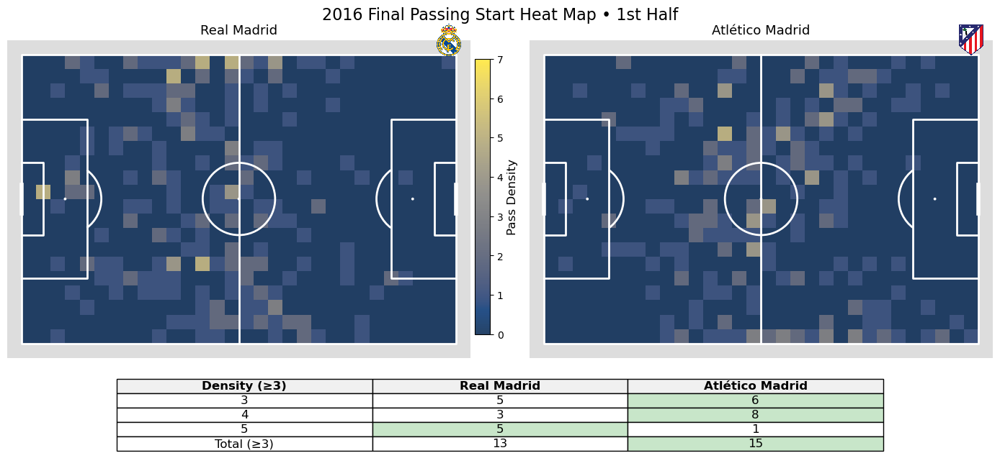

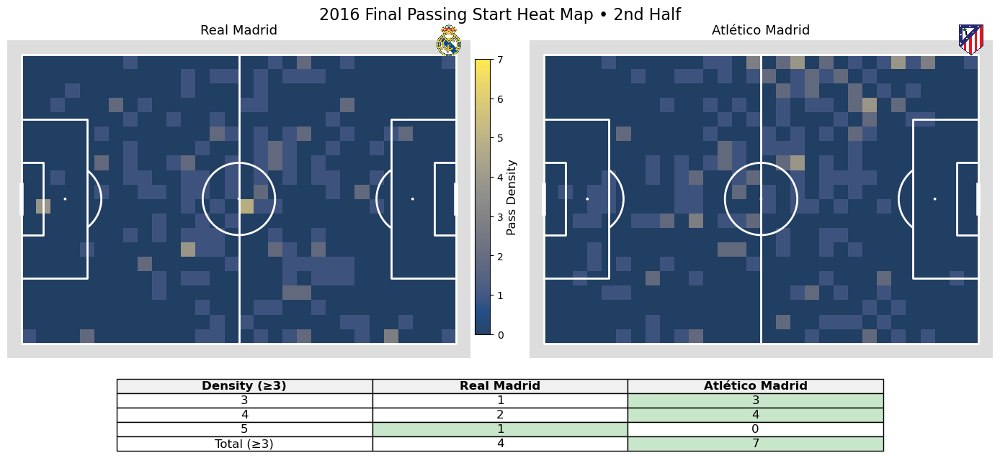

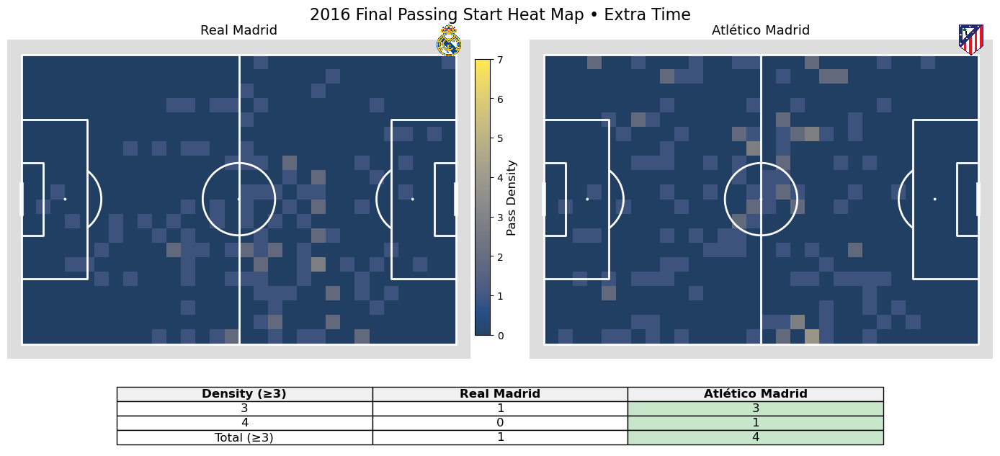

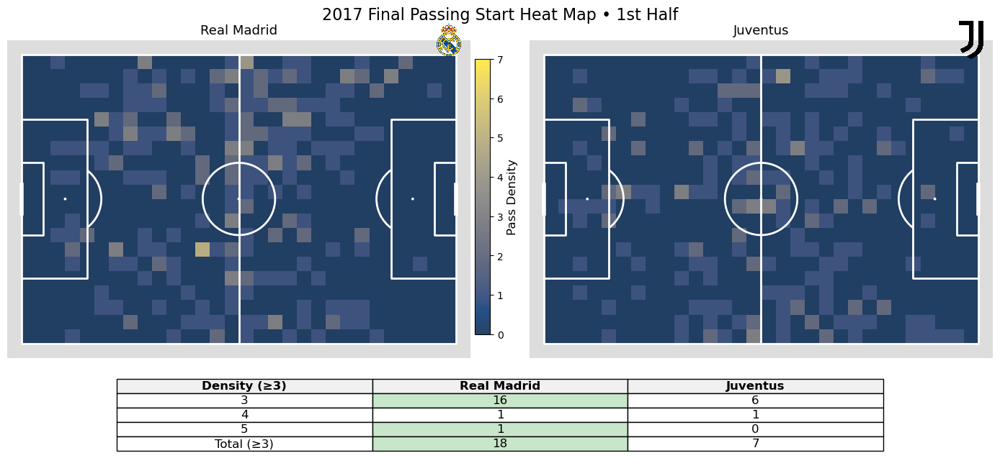

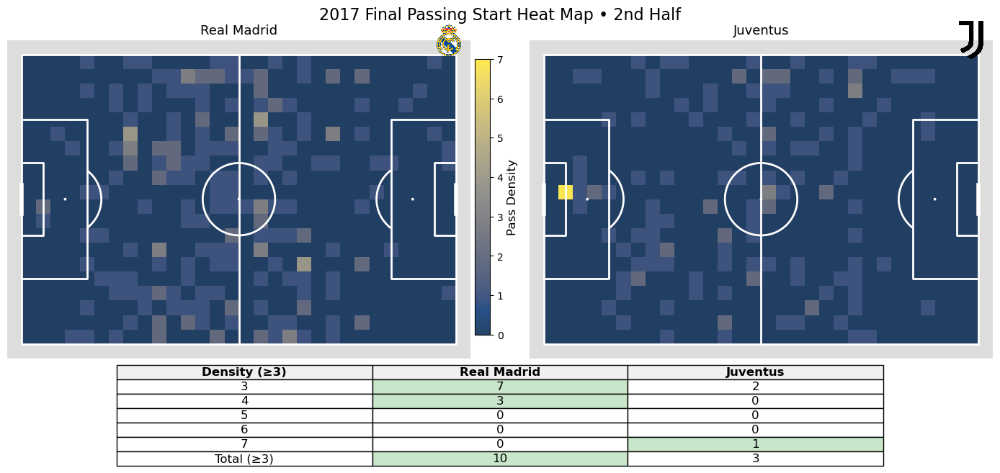

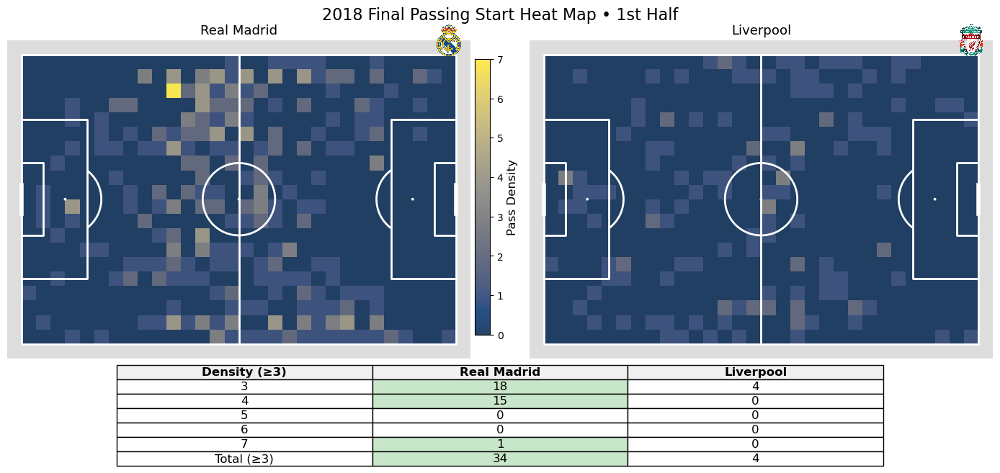

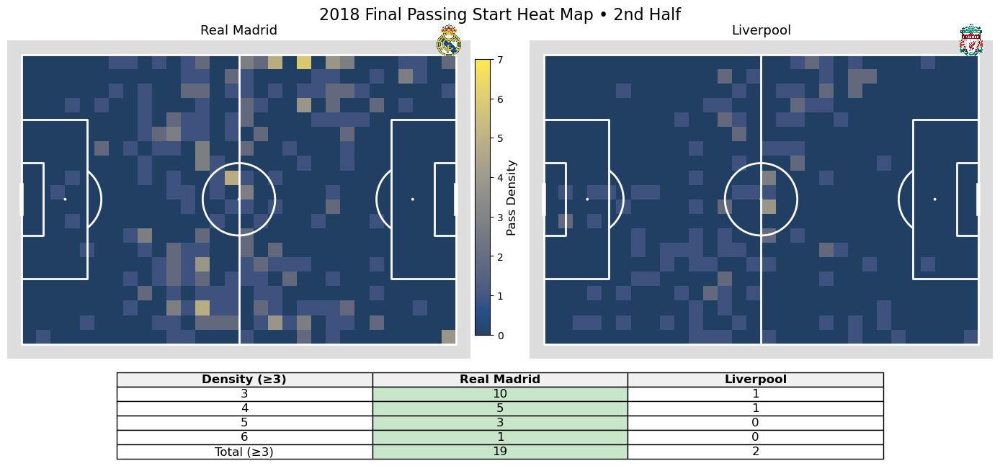

In [41]:
# Iterate through both teams' passing data across all matches, compute passing density by time period 
# (1st Half / 2nd Half / Extra Time). Find the maximum passing density among all matches and periods,
# and use it as the upper bound (vmax) of the global heatmap colorbar, ensuring consistent color scaling across plots.
def get_overall_vmax(matchup_list, bins_x=30, bins_y=20):

    # Initialization
    pitch = Pitch(pitch_type='statsbomb')
    max_val = 0  # Record the global maximum density (initialized as 0).
    period_labels = {
        '1st Half': [1],
        '2nd Half': [2],
        'Extra Time': [3, 4]
    }
    # Iterate through all matches
    for _, df1, df2, *_ in matchup_list:
        # Iterate through three periods
        for period in period_labels.values():
            df1_half = df1[df1['period'].isin(period)]
            df2_half = df2[df2['period'].isin(period)]
            # Compute passing density
            if not df1_half.empty:
                x1 = df1_half['location'].str[0].to_numpy()
                y1 = df1_half['location'].str[1].to_numpy()
                stat1 = pitch.bin_statistic(x1, y1, statistic='count', bins=(bins_x, bins_y))
                max_val = max(max_val, int(np.nanmax(stat1['statistic'])))
            if not df2_half.empty:
                x2 = df2_half['location'].str[0].to_numpy()
                y2 = df2_half['location'].str[1].to_numpy()
                stat2 = pitch.bin_statistic(x2, y2, statistic='count', bins=(bins_x, bins_y))
                max_val = max(max_val, int(np.nanmax(stat2['statistic'])))
    return max_val  # Return the global maximum value


# Plot side-by-side passing start location heatmaps for both teams in the same period. 
# Add a comparison table at the bottom, counting the number of grid cells with passing density ≥ 3,
# and highlight the team with more such cells.
def plot_grid_heatmap_comparison(
    df_team1,
    df_team2,
    title_prefix,
    team1_name,
    team2_name,
    match_year,
    save_name_prefix=None,
    bins_x=30,
    bins_y=20,
    cmap='cividis',
    vmax=None
):
    # Generate heatmap data and comparison tables for both teams across match periods
    def get_period_stats():
        # Initialization
        pitch_inner = Pitch(pitch_type='statsbomb')
        period_labels = {
            '1st Half': [1],
            '2nd Half': [2],
            'Extra Time': [3, 4]
        }
        period_stats = {}
        density_dfs = []
        value_count_dfs = []

        # Iterate through each match period
        for label, period_list in period_labels.items():
            df1_half = df_team1[df_team1['period'].isin(period_list)]
            df2_half = df_team2[df_team2['period'].isin(period_list)]
            if df1_half.empty and df2_half.empty:
                continue

            # Compute heatmap grid data for both teams
            stat_dict = {}
            if not df1_half.empty:
                x1 = df1_half['location'].str[0].to_numpy()
                y1 = df1_half['location'].str[1].to_numpy()
                stat1 = pitch_inner.bin_statistic(x1, y1, statistic='count', bins=(bins_x, bins_y))
                stat_dict['team1_obj'] = stat1
                stat_dict['team1'] = np.nan_to_num(stat1['statistic']).astype(float)
            else:
                zeros = np.zeros((bins_y, bins_x), dtype=float)
                stat_dict['team1_obj'] = {'statistic': zeros, 'x_grid': None, 'y_grid': None}
                stat_dict['team1'] = zeros

            if not df2_half.empty:
                x2 = df2_half['location'].str[0].to_numpy()
                y2 = df2_half['location'].str[1].to_numpy()
                stat2 = pitch_inner.bin_statistic(x2, y2, statistic='count', bins=(bins_x, bins_y))
                stat_dict['team2_obj'] = stat2
                stat_dict['team2'] = np.nan_to_num(stat2['statistic']).astype(float)
            else:
                zeros = np.zeros((bins_y, bins_x), dtype=float)
                stat_dict['team2_obj'] = {'statistic': zeros, 'x_grid': None, 'y_grid': None}
                stat_dict['team2'] = zeros

            period_stats[label] = stat_dict  # Store heatmap data for this period

            # Generate detailed density grid dataframe
            data = []
            for y in range(bins_y):
                for x in range(bins_x):
                    val1 = float(stat_dict['team1'][y, x])
                    val2 = float(stat_dict['team2'][y, x])
                    diff = val1 - val2
                    data.append({
                        'year': match_year,
                        'period': label,
                        'bin_x': x,
                        'bin_y': y,
                        'team1': team1_name,
                        'team2': team2_name,
                        'team1_density': val1,
                        'team2_density': val2,
                        'density_diff': diff
                    })
            df_density = pd.DataFrame(data)
            density_dfs.append(df_density)

            # Generate density value counts table
            v1 = pd.Series(stat_dict['team1'].flatten()).astype(int)
            v1 = v1.value_counts().reset_index()
            v1.columns = ['density', 'count']
            v1 = v1.sort_values(by='density')
            v1['team'] = team1_name
            v1['period'] = label
            v1['year'] = match_year

            v2 = pd.Series(stat_dict['team2'].flatten()).astype(int)
            v2 = v2.value_counts().reset_index()
            v2.columns = ['density', 'count']
            v2 = v2.sort_values(by='density')
            v2['team'] = team2_name
            v2['period'] = label
            v2['year'] = match_year

            value_count_dfs.append(pd.concat([v1, v2], ignore_index=True))

        return period_stats, pd.concat(density_dfs, ignore_index=True), pd.concat(value_count_dfs, ignore_index=True)

    # Create a StatsBomb pitch with gray background
    pitch = Pitch(pitch_type='statsbomb', pitch_color='#DDDDDD',
                  line_color='white', line_alpha=1, line_zorder=2)

    # Get data for the three periods
    period_stats, density_df, value_count_df = get_period_stats()

    # Iterate through each period and plot
    for label, stat_dict in period_stats.items():
        # Create figure
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6.6), facecolor='#FFFFFF', sharey=True)

        # Plot left heatmap
        pitch.draw(ax=ax1)
        pcm1 = pitch.heatmap(stat_dict['team1_obj'], ax=ax1,
                             cmap=cmap, edgecolors=None, alpha=0.85, vmax=vmax)
        ax1.set_title(f"{team1_name}", fontsize=13, color='black')
        # Add left team logo
        logo_uri1 = get_team_logo(team1_name)
        if logo_uri1:
            try:
                img_data = base64.b64decode(logo_uri1.split(",")[1])
                img = Image.open(io.BytesIO(img_data)).convert("RGBA")
                imagebox = OffsetImage(np.array(img), zoom=0.03)
                ab = AnnotationBbox(imagebox, (118, -4), frameon=False, xycoords='data')
                ax1.add_artist(ab)
            except Exception:
                pass  

        # Plot right heatmap
        pitch.draw(ax=ax2)
        pcm2 = pitch.heatmap(stat_dict['team2_obj'], ax=ax2,
                             cmap=cmap, edgecolors=None, alpha=0.85, vmax=vmax)
        ax2.set_title(f"{team2_name}", fontsize=13, color='black')
        logo_uri2 = get_team_logo(team2_name)
        # Add right team logo
        if logo_uri2:
            try:
                img_data = base64.b64decode(logo_uri2.split(",")[1])
                img = Image.open(io.BytesIO(img_data)).convert("RGBA")
                imagebox = OffsetImage(np.array(img), zoom=0.03)
                ab = AnnotationBbox(imagebox, (118, -4), frameon=False, xycoords='data')
                ax2.add_artist(ab)
            except Exception:
                pass

        # Set main title
        fig.suptitle(f"{title_prefix} • {label}", fontsize=16, color='black', y=0.97)

        # Add colorbar
        cax = fig.add_axes([0.475, 0.28, 0.015, 0.58])
        cbar = fig.colorbar(pcm1, cax=cax)
        cbar.set_label('Pass Density', color='black', fontsize=12)
        cbar.ax.yaxis.set_tick_params(color='black')
        plt.setp(cbar.ax.get_yticklabels(), color='black')

        # Flatten density arrays and determine density levels to count (≥3)
        a1 = np.nan_to_num(stat_dict['team1']).astype(int).flatten()
        a2 = np.nan_to_num(stat_dict['team2']).astype(int).flatten()

        # Find maximum density value among both teams
        max_d = int(max(a1.max() if a1.size else 0, a2.max() if a2.size else 0))
        start_d = 3   # Starting threshold for statistics
        densities = list(range(start_d, max_d + 1)) if max_d >= start_d else []

        # Count occurrences of each density level in an array
        def counts_for(arr, levels):
            if len(arr) == 0 or len(levels) == 0:
                return []
            vc = pd.Series(arr).value_counts()
            return [int(vc.get(d, 0)) for d in levels]  # Extract counts in order of levels

        # Compute number of "high-density cells" for each team
        counts1 = counts_for(a1, densities)
        counts2 = counts_for(a2, densities)

        total1 = int(np.sum(a1 >= start_d))
        total2 = int(np.sum(a2 >= start_d))

        # Build comparison table showing counts of cells at each density level (≥3).
        # Highlight the higher values for each row.
        table_rows = []
        header = ["Density (≥3)", team1_name, team2_name]
        table_rows.append(header)

        for d, c1, c2 in zip(densities, counts1, counts2):
            table_rows.append([str(d), str(c1), str(c2)])

        table_rows.append(["Total (≥3)", str(total1), str(total2)])

        # Create subplot for the table
        ax_tbl = fig.add_axes([0.12, 0.04, 0.76, 0.14])
        ax_tbl.axis('off')

        # Draw the table
        the_table = ax_tbl.table(
            cellText=table_rows,
            colLabels=None,
            cellLoc='center',
            loc='center'
        )
        # Table style
        the_table.auto_set_font_size(False)
        the_table.set_fontsize(12)
        the_table.scale(1, 1.2)

        # Header style
        for j in range(3):
            the_table[(0, j)].set_text_props(weight='bold')
            the_table[(0, j)].set_facecolor('#F0F0F0')

        # Highlight the higher value in each row (green)
        highlight_color = '#C8E6C9'
        for i in range(1, len(table_rows)):
            try:
                v1 = int(table_rows[i][1])
                v2 = int(table_rows[i][2])
            except ValueError:
                v1, v2 = 0, 0
            if v1 > v2:
                the_table[(i, 1)].set_facecolor(highlight_color)
            elif v2 > v1:
                the_table[(i, 2)].set_facecolor(highlight_color)

        # Adjust overall layout
        plt.subplots_adjust(left=0.01, right=0.99, top=0.90, bottom=0.23, wspace=0.12)

        # Save and show
        if save_name_prefix:
            suffix = label.replace(" ", "_")
            fig.savefig(f"{save_name_prefix}_{suffix}.png", dpi=300, bbox_inches='tight')

        plt.show()

    return density_df, value_count_df

# Batch execution
matchups = [
    ("2016 Final", RM_passes_2016, AM_passes_2016, "Real Madrid", "Atlético Madrid", "2016", "heatmap_cmp_2016"),
    ("2017 Final", RM_passes_2017, JV_passes_2017, "Real Madrid", "Juventus",        "2017", "heatmap_cmp_2017"),
    ("2018 Final", RM_passes_2018, LP_passes_2018, "Real Madrid", "Liverpool",       "2018", "heatmap_cmp_2018"),
]

vmax_global = get_overall_vmax([(t, df1, df2) for t, df1, df2, *_ in matchups], bins_x=30, bins_y=20)

all_density_dfs = []
all_value_counts_dfs = []

for title, df1, df2, team1, team2, match_year, save_prefix in matchups:
    df_density, df_counts = plot_grid_heatmap_comparison(
        df_team1=df1,
        df_team2=df2,
        title_prefix=f"{title} Passing Start Heat Map",
        team1_name=team1,
        team2_name=team2,
        match_year=match_year,
        save_name_prefix=save_prefix,
        bins_x=30,
        bins_y=20,
        cmap='cividis',
        vmax=vmax_global
    )
    all_density_dfs.append(df_density)
    all_value_counts_dfs.append(df_counts)

# Export CSV files
pd.concat(all_density_dfs, ignore_index=True).to_csv("all_years_pass_density_comparison.csv", index=False)
pd.concat(all_value_counts_dfs, ignore_index=True).to_csv("pass_density_value_counts_by_period.csv", index=False)


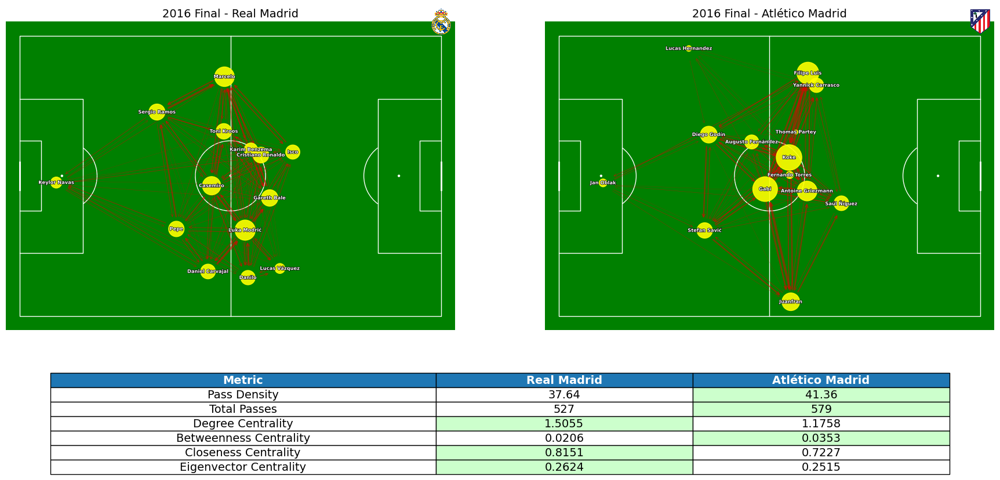

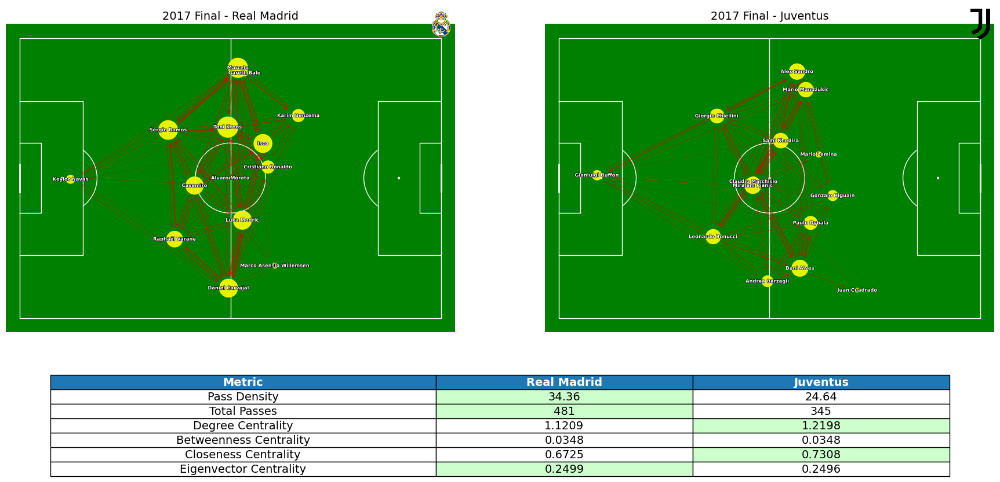

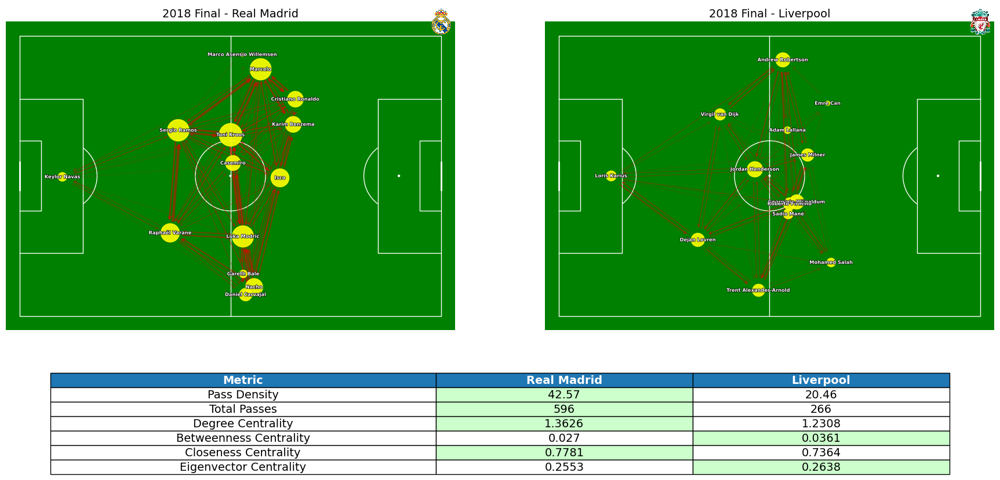

In [42]:
# Draw passing network comparison charts for Real Madrid and their opponents in the 2016, 2017, and 2018 UCL finals

# Build passing network: convert a team's pass event DataFrame into a passing network graph
# (players are nodes, passes are directed edges), and calculate players' average positions and edge weights.
def build_pass_network(passes_df):
    passes_df = passes_df.copy()
    # Extract all passers and receivers from the data and take the union.
    starting_players = sorted(set(passes_df["player.name"]).union(set(passes_df["pass.recipient.name"])))

    # Filter to only keep passes between players in the starting players list.
    passes_df = passes_df[
        passes_df["player.name"].isin(starting_players) &
        passes_df["pass.recipient.name"].isin(starting_players)
    ].copy()

    pos_dict = defaultdict(list)
    # Iterate through each pass, store the passer's location in pos_dict[player].
    for _, row in passes_df.iterrows():
        loc = row["location"]
        if isinstance(loc, list):
            pos_dict[row["player.name"]].append(loc)

    # Compute each player's average touch location (mean of coordinates).
    # Result: avg_pos = {player_name: [x, y]}, used to position nodes.
    avg_pos = {player: np.mean(pos_list, axis=0).tolist() for player, pos_list in pos_dict.items()}

    # Group by "passer → receiver" and count the number of passes.
    # This gives edge weights: how many passes between each pair of players.
    edge_weights = passes_df.groupby([
        "player.name", "pass.recipient.name"]).size().reset_index(name="count")

    G = nx.DiGraph()  # Create a directed graph G
    # Add all players as nodes.
    for player in starting_players:
        # Add node with its average position. If no coordinates available
        # (e.g., only received passes), use default [60,40] (center of pitch).
        coords = avg_pos.get(player, [60, 40])
        G.add_node(player, pos=coords)

    # Add edges between players, weighted by pass counts.
    for _, row in edge_weights.iterrows():
        G.add_edge(row["player.name"], row["pass.recipient.name"], weight=row["count"])

    return G, edge_weights, avg_pos, passes_df


# Compute network metrics
def compute_network_metrics(G, passes_df):
    degree_centrality = np.mean(list(nx.degree_centrality(G).values())) # average degree centrality
    betweenness = np.mean(list(nx.betweenness_centrality(G).values())) # average betweenness centrality
    closeness = np.mean(list(nx.closeness_centrality(G).values())) # average closeness centrality
    eigenvector = np.mean(list(nx.eigenvector_centrality_numpy(G).values())) # average eigenvector centrality
    pass_density = round(len(passes_df) / len(G.nodes), 2) if len(G.nodes) > 0 else 0  # pass density
    return {
        "Pass Density": pass_density,
        "Total Passes": len(passes_df),
        "Degree Centrality": round(degree_centrality, 4),
        "Betweenness Centrality": round(betweenness, 4),
        "Closeness Centrality": round(closeness, 4),
        "Eigenvector Centrality": round(eigenvector, 4)
    }


# Draw passing networks for both teams (side by side) + a comparison table at the bottom
def draw_combined_networks(G1, edge_weights1, avg_pos1, passes_df1, metrics1, team1,
                           G2, edge_weights2, avg_pos2, passes_df2, metrics2, team2,
                           match_label, save_name):
    # Initialize pitch and figure layout
    pitch = Pitch(pitch_type='statsbomb', pitch_color='green', line_color='white', linewidth=1)
    fig = plt.figure(figsize=(22, 10))
    gs = gridspec.GridSpec(2, 2, height_ratios=[7, 1], hspace=0.25)

    positions = [avg_pos1, avg_pos2]
    graphs = [G1, G2]
    edge_lists = [edge_weights1, edge_weights2]
    passes_dfs = [passes_df1, passes_df2]
    teams = [team1, team2]
    metrics_list = [metrics1, metrics2]

    # Loop over both teams (left and right)
    for col in range(2):
        ax_pitch = fig.add_subplot(gs[0, col])
        pitch.draw(ax=ax_pitch)

        G = graphs[col]
        edge_weights = edge_lists[col]
        avg_pos = positions[col]
        passes_df = passes_dfs[col]
        team_name = teams[col]

        # Prepare data
        pos = {node: G.nodes[node]["pos"] for node in G.nodes}
        pass_counts = defaultdict(int)
        for _, row in passes_df.iterrows():
            pass_counts[row["player.name"]] += 1
            pass_counts[row["pass.recipient.name"]] += 1
        node_sizes = [pass_counts.get(node, 1) * 5 for node in G.nodes]

        # Draw player nodes + names
        nx.draw_networkx_nodes(G, pos=pos, ax=ax_pitch, node_color="yellow", node_size=node_sizes, alpha=0.9)
        for node, (x, y) in pos.items():
            text = ax_pitch.text(x, y, node, fontsize=6, color="white", ha="center", va="center", fontweight="bold")
            text.set_path_effects([path_effects.Stroke(linewidth=1.0, foreground="black"), path_effects.Normal()])

        # Draw passing arrows (edges)
        norm = Normalize(vmin=edge_weights["count"].min(), vmax=edge_weights["count"].max())
        offset = 0.5
        gap = 3

        def adjust_arrow_endpoints(start, end, gap=8):
            dx, dy = end[0]-start[0], end[1]-start[1]
            dist = np.hypot(dx, dy)
            if dist == 0:
                return start, end
            offset_x = dx / dist * gap
            offset_y = dy / dist * gap
            return (start[0]+offset_x, start[1]+offset_y), (end[0]-offset_x, end[1]-offset_y)

        for _, row in edge_weights.iterrows():
            u, v, w = row["player.name"], row["pass.recipient.name"], row["count"]
            if u == v:
                continue
            x1, y1 = pos[u]
            x2, y2 = pos[v]
            dx, dy = x2 - x1, y2 - y1
            dist = np.hypot(dx, dy)
            offset_x = -dy / dist * offset
            offset_y = dx / dist * offset
            start_raw = (x1 + offset_x, y1 + offset_y)
            end_raw = (x2 + offset_x, y2 + offset_y)
            start, end = adjust_arrow_endpoints(start_raw, end_raw, gap=gap)
            color = (0.9, 0.0, 0.0, norm(w))
            arrow = FancyArrowPatch(posA=start, posB=end, arrowstyle="->", color=color,
                                    linewidth=0.1 + w * 0.15, mutation_scale=8, alpha=0.5)
            ax_pitch.add_patch(arrow)

        # Add team logo outside the pitch
        logo_uri = get_team_logo(team_name)
        if logo_uri:
            base64_str = logo_uri.split(",")[1]
            image_data = base64.b64decode(base64_str)
            image = Image.open(io.BytesIO(image_data)).convert("RGBA")
            imagebox = OffsetImage(np.asarray(image), zoom=0.03)
            ab = AnnotationBbox(imagebox, (120, -4.0), frameon=False, xycoords="data")
            ax_pitch.add_artist(ab)

        ax_pitch.set_title(f"{match_label} - {team_name}", fontsize=14, color="black")

    # Draw comparison table
    ax_table = fig.add_subplot(gs[1, :])
    ax_table.axis("off")

    # Prepare table data
    headers = ["Metric", team1, team2]
    table_data = []
    for key in metrics1.keys():
        val1 = metrics1[key]
        val2 = metrics2[key]
        row = [key, str(val1), str(val2)]
        table_data.append(row)

    # Draw table + highlight the better team
    table = ax_table.table(
        cellText=table_data,
        colLabels=headers,
        loc="center",
        cellLoc="center",
        edges="closed",
        colWidths=[0.3, 0.2, 0.2]
    )
    table.auto_set_font_size(False)
    table.set_fontsize(14)
    table.scale(1.3, 1.5)

    for (row, col), cell in table.get_celld().items():
        if row == 0:
            cell.set_text_props(weight='bold', color='white')
            cell.set_facecolor('#1f77b4')
        elif col in [1, 2] and row > 0:
            key = table_data[row - 1][0]
            v1 = float(metrics1[key])
            v2 = float(metrics2[key])
            if (col == 1 and v1 > v2) or (col == 2 and v2 > v1):
                cell.set_facecolor("#ccffcc")  # highlight in light green

    # Save and show figure
    plt.savefig(save_name, dpi=300, bbox_inches="tight")
    plt.show()


# Batch process matches
def process_match_pair(events_df, match_label, team1, team2):
    passes1 = events_df[(events_df["type.name"] == "Pass") & (events_df["team.name"] == team1) & (events_df["pass.outcome.name"].isna())]
    passes2 = events_df[(events_df["type.name"] == "Pass") & (events_df["team.name"] == team2) & (events_df["pass.outcome.name"].isna())]
    G1, ew1, pos1, pf1 = build_pass_network(passes1)
    G2, ew2, pos2, pf2 = build_pass_network(passes2)
    m1 = compute_network_metrics(G1, pf1)
    m2 = compute_network_metrics(G2, pf2)

    save_name = f"{match_label.replace(' ', '_')}_Combined.png"
    draw_combined_networks(G1, ew1, pos1, pf1, m1, team1,
                           G2, ew2, pos2, pf2, m2, team2,
                           match_label, save_name)

# Match list
matches = [
    ("2016 Final", EUChampions16finalevent, "Real Madrid", "Atlético Madrid"),
    ("2017 Final", EUChampions17finalevent, "Real Madrid", "Juventus"),
    ("2018 Final", EUChampions18finalevent, "Real Madrid", "Liverpool")
]

for match_label, events_df, team1, team2 in matches:
    process_match_pair(events_df, match_label, team1, team2)


In [43]:
# --- Build Graph from Passes ---
def build_passing_graph(passes_df):
    G = nx.DiGraph()
    edge_weights = passes_df.groupby(['player.name', 'pass.recipient.name']).size().reset_index(name='count')
    for _, row in edge_weights.iterrows():
        G.add_edge(row['player.name'], row['pass.recipient.name'], weight=row['count'])
    return G


RM_G_2018 = build_passing_graph(RM_passes_2018)   # Real Madrid passing network, 2018 final
RM_G_2017 = build_passing_graph(RM_passes_2017)   # Real Madrid passing network, 2017 final
RM_G_2016 = build_passing_graph(RM_passes_2016)   # Real Madrid passing network, 2016 final
LP_G_2018 = build_passing_graph(LP_passes_2018)   # Liverpool passing network, 2018 final
JV_G_2017 = build_passing_graph(JV_passes_2017)   # Juventus passing network, 2017 final
AM_G_2016 = build_passing_graph(AM_passes_2016)   # Atlético Madrid passing network, 2016 final


In [44]:
# --- Compute Network Metrics ---
def compute_network_metrics(G, year=None, team_name=None):

    # --- Node-level metrics (per player) ---

    # Degree: number of connections = passes made + passes received
    # In football, this represents how involved a player is in passing; 
    # players with high degree are usually key hubs in ball circulation.
    degree = dict(G.degree())

    # Degree Centrality: normalized degree (0~1)
    # Useful for comparing player involvement across different networks.
    degree_centrality = nx.degree_centrality(G)

    # Betweenness Centrality: fraction of shortest paths that pass through a player
    # Reflects a player’s role as a “transit hub” in team passing organization.
    betweenness = nx.betweenness_centrality(G)

    # Closeness Centrality: inverse of average shortest path length to all others
    # High closeness means a player can efficiently connect with the whole team.
    closeness = nx.closeness_centrality(G)

    # Eigenvector Centrality: considers not only direct connections, 
    # but also the importance of connected players.
    # Useful for detecting the "core circle" of playmakers (e.g., midfield generals).
    try:
        eigenvector = nx.eigenvector_centrality(G, max_iter=1000)
    except nx.PowerIterationFailedConvergence:
        # If the algorithm does not converge (possible in small or sparse networks), set all to 0
        eigenvector = {node: 0 for node in G.nodes()}

    # PageRank: adapted from search engines, measures importance of being passed to
    # A player frequently targeted, especially by other key players, gets a high PageRank score.
    pagerank = nx.pagerank(G)

    # Katz Centrality: accumulates influence over direct and indirect paths
    # Identifies players contributing to multiple passing chains.
    try:
        # Compute the largest eigenvalue of the adjacency matrix
        A = nx.adjacency_matrix(G).todense()
        eigenvalues = np.linalg.eigvals(A)
        lambda_max = max(abs(eigenvalues))
        # alpha must be less than 1 / max eigenvalue
        safe_alpha = 0.9 / lambda_max
        katz = nx.katz_centrality(G, alpha=safe_alpha, beta=1.0)
        # Fix None or NaN values
        katz = {k: (0 if v is None or pd.isna(v) else v) for k, v in katz.items()}
    except Exception as e:
        print(f"Katz calculation failed: {e}")
        katz = {node: 0 for node in G.nodes()}

    # HITS Algorithm: Hub score & Authority score
    # Hub score: measures how much a player distributes the ball (“pass hub”).
    # Authority score: measures how much a player is a target of passes (“receiving hub”).
    try:
        hubs, authorities = nx.hits(G, max_iter=1000)
    except nx.PowerIterationFailedConvergence:
        hubs = {node: 0 for node in G.nodes()}
        authorities = {node: 0 for node in G.nodes()}

    # Clustering Coefficient: whether a player's passing partners also pass to each other
    # High clustering indicates frequent small group play (e.g., triangles).
    clustering = nx.clustering(G.to_undirected())
    
    # Participation in the maximum clique
    max_clique_size = 0
    max_clique_nodes = set()
    try:
        cliques = list(nx.find_cliques(G.to_undirected()))
        max_clique_size = max(len(c) for c in cliques)
        for c in cliques:
            if len(c) == max_clique_size:
                max_clique_nodes.update(c)
    except Exception:
        pass
    in_max_clique = {node: int(node in max_clique_nodes) for node in G.nodes()}

    # Node names (already normalized to player nicknames)
    player_names = list(G.nodes())

    # Combine all node-level metrics into a DataFrame
    df = pd.DataFrame({
        'Player': player_names,
        'degree': pd.Series(degree),
        'degree centrality': pd.Series(degree_centrality),
        'betweenness': pd.Series(betweenness),
        'closeness': pd.Series(closeness),
        'eigenvector': pd.Series(eigenvector),
        'pagerank': pd.Series(pagerank),
        'katz': pd.Series(katz),
        'hub score': pd.Series(hubs),
        'authority score': pd.Series(authorities),
        'clustering': pd.Series(clustering),
        'clique': pd.Series(in_max_clique)
    })

    # --- Network-level metrics (whole team) ---

    # Density: ratio of actual passing connections vs maximum possible connections
    # High density indicates tightly connected passing structures.
    density = nx.density(G)

    # Assortativity: whether high-degree players tend to pass more to each other
    # >0 means core players prefer connecting with each other, 
    # <0 means they distribute passes more to peripheral players.
    assortativity = nx.degree_assortativity_coefficient(G)

    # Reciprocity: proportion of mutual (two-way) passing connections
    # High reciprocity suggests more back-passes and one-two combinations.
    reciprocity = nx.reciprocity(G)

    # Transitivity: overall level of triangular passing structures
    # High values indicate active small-group interplay.
    transitivity = nx.transitivity(G)

    # Average shortest path length: minimum number of passes required to connect any two players
    # Smaller values indicate more efficient passing connectivity.
    try:
        if G.is_directed():
            # For directed graphs: take the largest strongly connected component
            largest_cc = max(nx.strongly_connected_components(G), key=len)
        else:
            largest_cc = max(nx.connected_components(G), key=len)
        subG = G.subgraph(largest_cc).copy()
        avg_shortest_path = nx.average_shortest_path_length(subG)
    except:
        avg_shortest_path = None

    # Add network-level metrics to each player’s row
    df_full = df.assign(
        year=year,
        team=team_name,
        **{
            "network density": density,
            "assortativity": assortativity,
            "reciprocity": reciprocity,
            "transitivity": transitivity,
            "average shortest path length": avg_shortest_path
        }
    )

    # Sort by degree (descending)
    return df_full.sort_values(by='degree', ascending=False).reset_index(drop=True)


# --- Collect metrics for all seasons/teams ---
all_dfs = []

# Compute separately for each team & season
df_rm_2016 = compute_network_metrics(RM_G_2016, year=2016, team_name="Real Madrid")
all_dfs.append(df_rm_2016)

df_rm_2017 = compute_network_metrics(RM_G_2017, year=2017, team_name="Real Madrid")
all_dfs.append(df_rm_2017)

df_rm_2018 = compute_network_metrics(RM_G_2018, year=2018, team_name="Real Madrid")
all_dfs.append(df_rm_2018)

df_am_2016 = compute_network_metrics(AM_G_2016, year=2016, team_name="Atlético Madrid")
all_dfs.append(df_am_2016)

df_jv_2017 = compute_network_metrics(JV_G_2017, year=2017, team_name="Juventus")
all_dfs.append(df_jv_2017)

df_lp_2018 = compute_network_metrics(LP_G_2018, year=2018, team_name="Liverpool")
all_dfs.append(df_lp_2018)

# Filter out empty DataFrames
non_empty_dfs = [
    df for df in all_dfs
    if not df.empty and df.dropna(axis=1, how='all').shape[1] > 0
]

# Merge all results into a single DataFrame
all_network_metrics = pd.concat(non_empty_dfs, ignore_index=True)

# Reorder columns: put year and team first
cols = all_network_metrics.columns.tolist()
cols_new = ['year', 'team'] + [c for c in cols if c not in ('year', 'team')]
all_network_metrics = all_network_metrics[cols_new]

# Save as CSV
all_network_metrics.to_csv("network_metrics_2016_2018.csv", index=False, encoding="utf-8-sig")

# Preview results
all_network_metrics


,year,team,Player,degree,degree centrality,betweenness,closeness,eigenvector,pagerank,katz,hub score,authority score,clustering,clique,network density,assortativity,reciprocity,transitivity,average shortest path length
0,2016,Real Madrid,Gareth Bale,24,1.846154,0.040471,1.000000,0.333371,0.095373,0.285220,0.061470,0.102044,0.833333,1,0.752747,-0.212312,0.861314,0.782334,1.247253
1,2016,Real Madrid,Luka Modrić,24,1.846154,0.037996,0.928571,0.319155,0.111182,0.279936,0.113366,0.104883,0.833333,1,0.752747,-0.212312,0.861314,0.782334,1.247253
2,2016,Real Madrid,Marcelo,24,1.846154,0.036877,0.928571,0.308676,0.107001,0.279410,0.113562,0.104719,0.833333,1,0.752747,-0.212312,0.861314,0.782334,1.247253
3,2016,Real Madrid,Casemiro,23,1.769231,0.027358,0.812500,0.278642,0.075046,0.268821,0.118226,0.079246,0.833333,1,0.752747,-0.212312,0.861314,0.782334,1.247253
4,2016,Real Madrid,Cristiano Ronaldo,22,1.692308,0.018882,0.928571,0.317554,0.083225,0.279914,0.061147,0.086687,0.893939,1,0.752747,-0.212312,0.861314,0.782334,1.247253
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78,2018,Liverpool,Virgil van Dijk,13,1.083333,0.010669,0.705882,0.254311,0.065711,0.272548,0.089597,0.079915,0.892857,0,0.615385,-0.237798,0.750000,0.717647,1.397436
79,2018,Liverpool,Loris Karius,12,1.000000,0.002345,0.571429,0.156253,0.042054,0.241642,0.091218,0.039910,0.944444,1,0.615385,-0.237798,0.750000,0.717647,1.397436
80,2018,Liverpool,Mohamed Salah,12,1.000000,0.009163,0.666667,0.242275,0.058824,0.264043,0.036412,0.042226,0.904762,0,0.615385,-0.237798,0.750000,0.717647,1.397436
81,2018,Liverpool,Adam Lallana,10,0.833333,0.014520,0.600000,0.159205,0.031881,0.242272,0.024529,0.030395,0.857143,0,0.615385,-0.237798,0.750000,0.717647,1.397436


In [45]:
# Plot trend lines + corresponding data tables for Real Madrid core players 
# who started in all three finals (2016/17/18), based on four network metrics. 
# Export each metric as an independent HTML page.
# Ensure network_metrics is already in memory
network_metrics = all_network_metrics.copy()

# Identify players who started in all three finals
rm_16 = set(RM_startingplayer16)
rm_17 = set(RM_startingplayer17)
rm_18 = set(RM_startingplayer18)

consistent_starters = sorted(rm_16 & rm_17 & rm_18)  # intersection = consistent starters
print("Players who started all three years:", consistent_starters)

# Since data already uses nicknames, use directly
core_players = consistent_starters

# Filter records for these players
subset = network_metrics[network_metrics["Player"].isin(core_players)].copy()
subset["year"] = subset["year"].astype(int)
subset = subset.sort_values(by=["Player", "year"])

years_sorted = sorted(subset["year"].unique())
rm_logo_path = get_team_logo("Real Madrid")

# Generate primary playing positions from lineups
rm_lineups = RM_lineup16 + RM_lineup17 + RM_lineup18
player_positions = {}
for p in rm_lineups:
    name = p["player_name"]  # already normalized as nickname
    pos_list = p.get("positions", [])
    if pos_list:
        pos_name = pos_list[0].get("position")
        if name not in player_positions:
            player_positions[name] = []
        player_positions[name].append(pos_name)

# Determine each player's main position (most frequent one across years)
player_main_position = {
    name: max(set(pos_list), key=pos_list.count)
    for name, pos_list in player_positions.items()
}

# Normalize raw positions into 4 main roles (Forward / Midfielder / Defender / Goalkeeper) 
# for consistent color mapping in line charts.
def classify_position(pos_name):
    if pos_name is None:
        return "Unknown"
    s = pos_name.lower()
    if "goalkeeper" in s:
        return "Goalkeeper"
    elif "back" in s:
        return "Defender"
    elif "midfield" in s:
        return "Midfielder"
    elif "wing" in s or "forward" in s:
        return "Forward"
    else:
        return "Unknown"

# Create player -> role mapping
position_map = {
    name: classify_position(player_main_position[name])
    for name in player_main_position
}

# Assign color for each role
position_colors = {
    "Midfielder": "blue",
    "Forward": "red",
    "Defender": "green",
    "Goalkeeper": "purple",
    "Unknown": "gray"
}

# Metrics to be plotted
metrics_to_plot = ["degree centrality", "betweenness", "eigenvector", "closeness"]
position_order = ["Forward", "Midfielder", "Defender", "Goalkeeper"]

# Export directory
output_dir = "rm_consistent_starters_html"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

for metric in metrics_to_plot:
    fig = go.Figure()
    metric_title = metric.replace("_", " ").title()

    # First group players by role order, then alphabetically within each role
    grouped_players = []
    for pos in position_order:
        players_in_pos = [p for p in core_players if position_map.get(p, "Unknown") == pos]
        grouped_players.extend(sorted(players_in_pos))

    table_rows = []
    all_numeric_values = {y: [] for y in years_sorted}
    trends = {}

    # Compute trend features (slope & stability)
    for player in grouped_players:
        pdata = subset[subset["Player"] == player].set_index("year")
        values = [pdata.at[y, metric] if y in pdata.index else np.nan for y in years_sorted]
        val_array = np.array(values, dtype=np.float64)
        slope = val_array[-1] - val_array[0] if np.all(np.isfinite(val_array)) else 0
        variance = np.nanvar(val_array) if np.all(np.isfinite(val_array)) else np.inf
        trends[player] = {"slope": slope, "variance": variance}

    # Identify the most stable player (lowest variance)
    most_stable_player = min(trends, key=lambda k: trends[k]["variance"])

    # Add line chart traces & build table rows
    for player in grouped_players:
        pdata = subset[subset["Player"] == player].set_index("year")
        values = []
        row_display = [player]
        row_numeric = [None]

        for y in years_sorted:
            val = pdata.at[y, metric] if y in pdata.index else None
            values.append(val)
            row_display.append(f"{val:.2f}" if val is not None else "-")
            row_numeric.append(val)
            all_numeric_values[y].append(val)

        # Add trend label (Rising / Declining / Stable)
        t = trends[player]
        label = "-"
        if t["slope"] > 0.005:
            label = "⬆️ Rising"
        elif t["slope"] < -0.005:
            label = "⬇️ Declining"
        if player == most_stable_player:
            label = "🔒 Most Stable" if label == "-" else label + " 🔒 Most Stable"

        row_display.append(label)
        row_numeric.append(None)
        table_rows.append((row_display, row_numeric))

        # Add line chart trace
        role = position_map.get(player, "Unknown")
        color = position_colors.get(role, "gray")
        fig.add_trace(go.Scatter(
            x=years_sorted,
            y=values,
            mode='lines+markers+text',
            name=f"{player} ({role})",
            text=[f"{v:.2f}" if v is not None else "" for v in values],
            textposition="top center",
            line=dict(width=2),
            marker=dict(size=8, color=color)
        ))

    # Highlight maximum values in table (rounded)
    highlight_map = {}
    for col_idx, y in enumerate(years_sorted, start=1):
        col_vals = [round(r[1][col_idx], 2) for r in table_rows if r[1][col_idx] is not None]
        if not col_vals:
            continue
        max_val_rounded = max(col_vals)
        for row_idx, r in enumerate(table_rows):
            val = r[1][col_idx]
            if val is not None and round(val, 2) == max_val_rounded:
                highlight_map.setdefault(col_idx, set()).add(row_idx)

    # Construct table cell colors
    num_rows = len(table_rows)
    total_cols = len(years_sorted) + 2  # Player + Years + Trend
    cell_fills = []
    for col_idx in range(total_cols):
        column_fill = []
        for row_idx in range(num_rows):
            if col_idx == 0 or col_idx == total_cols - 1:
                column_fill.append("white")
            elif col_idx in highlight_map and row_idx in highlight_map[col_idx]:
                column_fill.append("#FFF59D")
            else:
                column_fill.append("white")
        cell_fills.append(column_fill)

    # Add data table
    fig.add_trace(go.Table(
        header=dict(
            values=["Player"] + [str(y) for y in years_sorted] + ["Trend"],
            fill_color="lightgrey",
            align="center"
        ),
        cells=dict(
            values=[[r[0][i] for r in table_rows] for i in range(total_cols)],
            align="center",
            fill_color=cell_fills
        ),
        domain=dict(y=[0, 0.45])
    ))

    # Layout & logo
    fig.update_layout(
        title=dict(
            text=f"Real Madrid Consistent Starters {metric_title} Trajectory (2016–2018)",
            x=0.5,
            font=dict(size=18)
        ),
        xaxis=dict(title="", tickvals=years_sorted),
        yaxis=dict(title=metric_title, domain=[0.5, 1]),
        legend=dict(title="Player (Role)", font=dict(size=10)),
        hovermode="x unified",
        template="plotly_white",
        width=950,
        height=950
    )

    if rm_logo_path:
        fig.add_layout_image(
            dict(
                source=rm_logo_path,
                x=0.01,
                y=1.10,
                xref="paper",
                yref="paper",
                sizex=0.05,
                sizey=0.05,
                xanchor="left",
                yanchor="top",
                layer="above"
            )
        )

    # Local display
    fig.show()

    # Export as standalone HTML
    safe_metric = (metric
                   .replace(" ", "_")
                   .replace("/", "_")
                   .replace("\\", "_")
                   .replace(":", "_"))
    single_path = os.path.join(output_dir, f"Real_Madrid_{safe_metric}_trajectory_2016_2018.html")
    fig.write_html(single_path, include_plotlyjs="cdn", full_html=True)


Players who started all three years: ['Casemiro', 'Cristiano Ronaldo', 'Daniel Carvajal', 'Karim Benzema', 'Keylor Navas', 'Luka Modrić', 'Marcelo', 'Sergio Ramos', 'Toni Kroos']


In [47]:
# Compare whether the network centrality metrics of “core players” 
# (those who started in all three years 2016/2017/2018) 
# show significant changes across the three finals.

# Config: years and metrics to test
TARGET_YEARS = [2016, 2017, 2018]
METRICS = ["degree centrality", "betweenness", "eigenvector", "closeness"]

# Statistical function: Friedman test + post-hoc Wilcoxon
def run_friedman_and_posthoc(subset_df, core_players, metric, years):
    # Organize data by year for Friedman: 
    # For each year, collect the metric values for the same set of core players
    values_by_year = {
        y: [subset_df.loc[(subset_df["Player"] == p) & (subset_df["year"] == y), metric].values[0]
            for p in core_players
            if not subset_df.loc[(subset_df["Player"] == p) & (subset_df["year"] == y), metric].empty]
        for y in years
    }
    rows = [values_by_year[y] for y in years]
    friedman_stat, friedman_p = (np.nan, np.nan)
    if all(len(r) == len(rows[0]) for r in rows):
        friedman_stat, friedman_p = friedmanchisquare(*rows)

    # Post-hoc pairwise comparisons (Wilcoxon signed-rank test)
    posthoc = {}  # initialize

    def paired_vals(y1, y2):
        v1, v2 = [], []
        # Iterate through all core players; find their metric values in both years
        for p in core_players:
            row1 = subset_df[(subset_df["Player"] == p) & (subset_df["year"] == y1)][metric]
            row2 = subset_df[(subset_df["Player"] == p) & (subset_df["year"] == y2)][metric]
            # If both years have values and are not NaN, add them as a pair
            if not row1.empty and not row2.empty:
                val1, val2 = row1.values[0], row2.values[0]
                if pd.notna(val1) and pd.notna(val2):
                    v1.append(val1)
                    v2.append(val2)
        return v1, v2

    # Perform pairwise tests across the three year pairs
    for (y1, y2) in [(2016, 2017), (2017, 2018), (2016, 2018)]:
        v1, v2 = paired_vals(y1, y2)
        # Check conditions
        if len(v1) > 0 and len(v1) == len(v2):
            try:
                stat, p = wilcoxon(v1, v2)  # Wilcoxon signed-rank test
                posthoc[f"{y1} vs {y2}"] = (p, p < 0.05)  # store results in dict
            except:
                posthoc[f"{y1} vs {y2}"] = (np.nan, False)
        else:
            posthoc[f"{y1} vs {y2}"] = (np.nan, False)

    return friedman_stat, friedman_p, posthoc

# Build the overall results table
def build_significance_table(subset_df, core_players, years):
    results = []
    # Iterate over global METRICS and call the statistical function
    for metric in METRICS:
        friedman_stat, friedman_p, posthoc = run_friedman_and_posthoc(subset_df, core_players, metric, years)
        # Build one row of the results table
        row = {
            "Metric": metric,
            "Friedman Stat": round(friedman_stat, 4) if not np.isnan(friedman_stat) else "-",
            "Friedman p-value": round(friedman_p, 4) if not np.isnan(friedman_p) else "-",
            "Significant (p<0.05)": "Yes" if friedman_p < 0.05 else "No"
        }
        # Add post-hoc (Wilcoxon) result columns
        for k, (pval, sig) in posthoc.items():
            row[k] = f"{pval:.4f}" + (" *" if sig else "")
        # Append row and generate DataFrame
        results.append(row)
    return pd.DataFrame(results)

# Visualization as a table
def plot_significance_table(df, html_path=None):  
    # Prepare headers and cell text
    header_vals = list(df.columns)
    cell_vals = [[str(val) + (" ✅" if "*" in str(val) else "") for val in df[col]] for col in header_vals]

    # Compute background color for each cell
    cell_colors = []
    for col in header_vals:
        col_colors = []
        for val in df[col].astype(str):
            if col == "Friedman p-value":
                try:
                    color = "#d0f0c0" if float(val) < 0.05 else "white"
                except:
                    color = "white"
            elif "vs" in col:
                color = "#fff7b2" if "*" in val else "white"
            else:
                color = "white"
            col_colors.append(color)
        cell_colors.append(col_colors)

    # Construct Plotly table    
    fig = go.Figure(
        data=[
            go.Table(
                header=dict(
                    values=[f"<b>{col}</b>" for col in header_vals],
                    fill_color="lightblue",
                    align="center",
                    font=dict(size=14)
                ),
                cells=dict(
                    values=cell_vals,
                    align="center",
                    fill_color=cell_colors,
                    font=dict(size=14)
                )
            )
        ]
    )
    # Layout
    fig.update_layout(
        title=dict(
            text="Core Players Centrality Friedman & Post-hoc Significance Test Results (2016–2018)",
            x=0.5,
            xanchor="center",
            font=dict(size=18)
        ),
        width=1150,
        height=310
    )
    fig.show()  # display

    # Export HTML file
    if html_path:
        fig.write_html(html_path)

# Generate English summary
def generate_summary_en(df):
    lines = []
    for _, row in df.iterrows():
        metric = row["Metric"].replace("_", " ").title()
        for comp in ["2016 vs 2017", "2017 vs 2018", "2016 vs 2018"]:
            val = row.get(comp, "")
            if "*" in val:
                pval = val.replace(" *", "")
                lines.append(f"✅ The metric '{metric}' shows a statistically significant difference between {comp} (p = {pval})")
    return lines

# Run analysis

# Run significance tests
result_df = build_significance_table(subset, core_players, TARGET_YEARS)

# Visualization
plot_significance_table(result_df, html_path="Coreplayers_centrality_significance_table.html")

# Summary
summary_lines = generate_summary_en(result_df)
print("\n📝 Summary of Significant Changes (English):")
if summary_lines:
    for line in summary_lines:
        print(line)
else:
    print("No statistically significant differences were found across the three years for any metric (p ≥ 0.05).")




📝 Summary of Significant Changes (English):
No statistically significant differences were found across the three years for any metric (p ≥ 0.05).


In [49]:
# Extract year and merge two data sources
team_stats_df["year"] = team_stats_df["match"].str.extract(r"(\d{4})").astype(int)
merged_df = pd.merge(team_stats_df, all_network_metrics, on=["team", "year"], how="left")

# Keep only Real Madrid data
rm_df = merged_df[merged_df["team"] == "Real Madrid"].copy()

# Metrics and years
metrics = ["xG", "goals", "key passes", "pass success rate", "shots", "interceptions", "clearances", "blocks", "possession", "network density", "closeness", "eigenvector", "betweenness", "degree centrality"]
years = sorted(rm_df["year"].unique())

# Convert percentage strings to decimal values
def clean_percentage_column(df, col):
    if col in df.columns:
        df[col] = df[col].astype(str).str.replace('%', '').astype(float) / 100

# Clean columns that need conversion
for col in ["pass success rate", "possession"]:
    clean_percentage_column(rm_df, col)

# Statistical tests: Friedman + Wilcoxon test function
def run_stat_tests(df, metrics, years):
    results = []
    for metric in metrics:
        data_by_year = [df[df["year"] == y][metric].values for y in years]
        friedman_stat, friedman_p = np.nan, np.nan

        if all(len(v) > 0 for v in data_by_year):
            try:
                friedman_stat, friedman_p = friedmanchisquare(*data_by_year)
            except:
                pass

        posthoc = {}
        for y1, y2 in [(2016, 2017), (2017, 2018), (2016, 2018)]:
            v1 = df[df["year"] == y1][metric].values
            v2 = df[df["year"] == y2][metric].values
            if len(v1) == len(v2) and len(v1) > 1:
                try:
                    stat, p = wilcoxon(v1, v2)
                    posthoc[f"{y1} vs {y2}"] = (p, p < 0.05)
                except:
                    posthoc[f"{y1} vs {y2}"] = (np.nan, False)
            else:
                posthoc[f"{y1} vs {y2}"] = (np.nan, False)

        row = {
            "Metric": metric,
            "Friedman Stat": f"{friedman_stat:.4f}" if not np.isnan(friedman_stat) else "-",
            "Friedman p-value": f"{friedman_p:.6f}" if not np.isnan(friedman_p) else "-",
            "Significant (p<0.05)": "Yes" if not np.isnan(friedman_p) and friedman_p < 0.05 else "No"
        }

        for k, (pval, sig) in posthoc.items():
            if not np.isnan(pval):
                row[k] = f"{pval:.4f}" + (" *" if sig else "")
            else:
                row[k] = "-"
        results.append(row)

    return pd.DataFrame(results)

# Visualization: bar chart + heatmap
def plot_friedman_and_heatmap(result_df):
    # Bar chart
    bar_data = result_df[result_df["Friedman p-value"] != "-"].copy()
    bar_data["Friedman p-value"] = bar_data["Friedman p-value"].astype(float)

    fig_bar = go.Figure()
    fig_bar.add_trace(go.Bar(
        x=bar_data["Metric"],
        y=bar_data["Friedman p-value"],
        text=bar_data["Friedman p-value"].apply(lambda x: f"{x:.6f}"),
        textposition="outside",
        marker_color="lightblue"
    ))
    fig_bar.update_layout(
        title=dict(text="Friedman Test p-values (2016–2018) - Real Madrid", x=0.5),
        yaxis=dict(title="p-value", range=[0, max(bar_data["Friedman p-value"].max() + 0.1, 0.8)]),
        template="plotly_white",
        height=400
    )
    fig_bar.show()
    fig_bar.write_html("Real_Madrid_Key_Tactical_Indicators_Friedman_pvalues_Bar.html")

    # Heatmap
    heatmap_data = result_df.set_index("Metric")[
        ["2016 vs 2017", "2017 vs 2018", "2016 vs 2018"]
    ].replace("-", np.nan)

    for col in heatmap_data.columns:
        heatmap_data[col] = heatmap_data[col].astype(str).str.replace(" *", "", regex=False)
        heatmap_data[col] = pd.to_numeric(heatmap_data[col], errors="coerce")

    fig_heatmap = go.Figure(data=go.Heatmap(
        z=heatmap_data.values,
        x=heatmap_data.columns.tolist(),
        y=heatmap_data.index.tolist(),
        colorscale="RdBu_r",
        zmin=0, zmax=1,
        colorbar=dict(title="p-value"),
        text=[[f"{v:.4f}" if not pd.isna(v) else "" for v in row] for row in heatmap_data.values],
        texttemplate="%{text}",
        hovertemplate="Metric: %{y}<br>Comparison: %{x}<br>p-value: %{z:.4f}<extra></extra>"
    ))

    fig_heatmap.update_layout(
        title=dict(text="Post-hoc Wilcoxon Test Heatmap (p-values) - Real Madrid", x=0.5),
        template="plotly_white",
        width=800,
        height=450
    )
    fig_heatmap.show()
    fig_heatmap.write_html("Real_Madrid_Key_Tactical_Indicators_Wilcoxon_Heatmap.html")

# Execute and export results
result_df = run_stat_tests(rm_df, metrics, years)
result_df.to_csv("Real_Madrid_Key_Tactical_Indicators_Significance_Test.csv", index=False, encoding="utf-8-sig")
plot_friedman_and_heatmap(result_df)
